# Libs

In [ ]:
import arrow
from icecream import ic
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from pandas.tseries.holiday import AbstractHolidayCalendar, Holiday, MO, USFederalHolidayCalendar
from prophet import Prophet

C:\Users\DV\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Load Data

In [ ]:
data = pd.read_csv("data_wf.csv")
data.head()

,Date,No_of_calls_from_commercial_card,No_of_calls_from_retail_card,No_of_calls_from_student_card
0,1/1/2017,264.0,403.0,860.0
1,1/2/2017,528.0,792.0,1681.0
2,1/3/2017,2505.0,3774.0,7639.0
3,1/4/2017,2145.0,3236.0,6513.0
4,1/5/2017,2164.0,3265.0,6604.0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1765 entries, 0 to 1764
Data columns (total 4 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Date                              1673 non-null   object 
 1   No_of_calls_from_commercial_card  1581 non-null   float64
 2   No_of_calls_from_retail_card      1581 non-null   float64
 3   No_of_calls_from_student_card     1581 non-null   float64
dtypes: float64(3), object(1)
memory usage: 55.3+ KB


# EDA

In [ ]:
# Copy Data
df = data.copy()

In [ ]:
df = df.dropna(how='any')

In [ ]:
df.rename(columns={"Date":"date", "No_of_calls_from_commercial_card":"cc", "No_of_calls_from_retail_card":"rc", "No_of_calls_from_student_card":"sc"}, inplace=True)

In [ ]:
df['date'] = df['date'].apply(lambda row: arrow.get(row, "M/D/YYYY").format("DD/MM/YYYY"))

In [ ]:
df['day'] = df['date'].apply(lambda row: arrow.get(row, "DD/MM/YYYY").day)
df['month'] = df['date'].apply(lambda row: arrow.get(row, "DD/MM/YYYY").month)
df['year'] = df['date'].apply(lambda row: arrow.get(row, "DD/MM/YYYY").year)

In [ ]:
df.head()

,date,cc,rc,sc,day,month,year
0,01/01/2017,264.0,403.0,860.0,1,1,2017
1,02/01/2017,528.0,792.0,1681.0,2,1,2017
2,03/01/2017,2505.0,3774.0,7639.0,3,1,2017
3,04/01/2017,2145.0,3236.0,6513.0,4,1,2017
4,05/01/2017,2164.0,3265.0,6604.0,5,1,2017


In [ ]:
# 2017 Dataframe
df_17 = df[df['year'] == 2017]

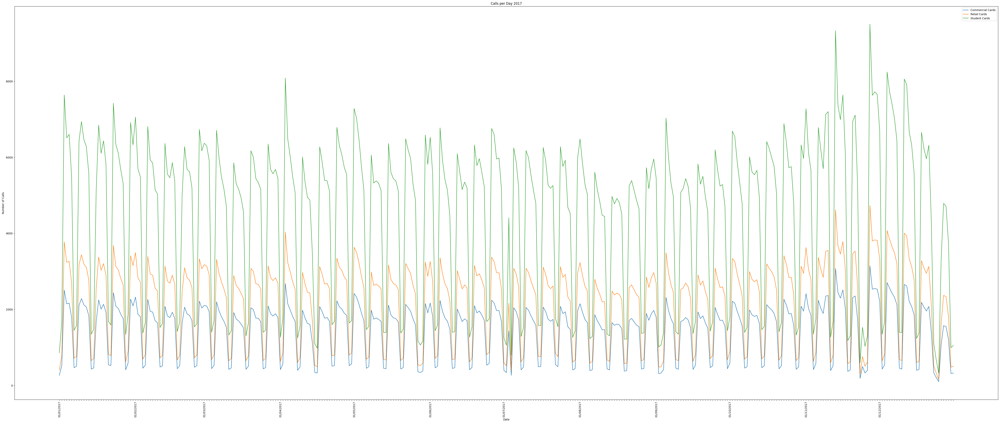

In [ ]:
# Plot calls per day for Commercial, Retail, and Student Cards
x = range(len(df_17['date']))
cc_values = df_17.cc
rc_values = df_17.rc
sc_values = df_17.sc
fig = plt.figure()
fig.set_figheight(20)
fig.set_figwidth(50)
ax = fig.add_axes([1,1,1,1])
ax.plot(x, cc_values, label='Commercial Cards')
ax.plot(x, rc_values, label='Retail Cards')
ax.plot(x, sc_values, label='Student Cards')
ax.set_xticks(x, [ dt if arrow.get(dt, "DD/MM/YYYY").day==1 else "" for dt in df_17['date'] ], rotation=90)
ax.set_xlabel("Date")
ax.set_ylabel("Number of Calls")
ax.set_title("Calls per Day 2017")
ax.legend()
plt.show()

In [ ]:
# Trend Observed
# cc is lowest for every observation
# rc is middle
# sc is highest
obs = df_17.shape[0]
print(((df_17.cc < df_17.rc) & (df_17.rc < df_17.sc)).sum() == obs)

True


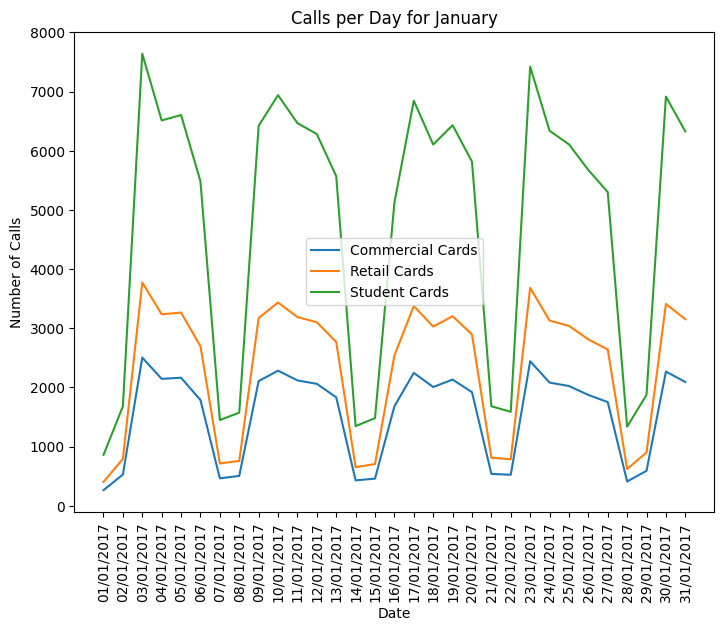

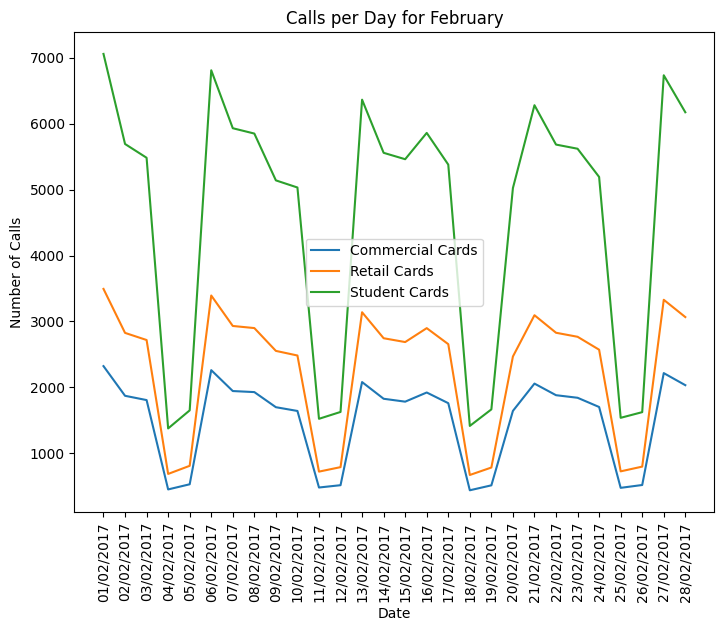

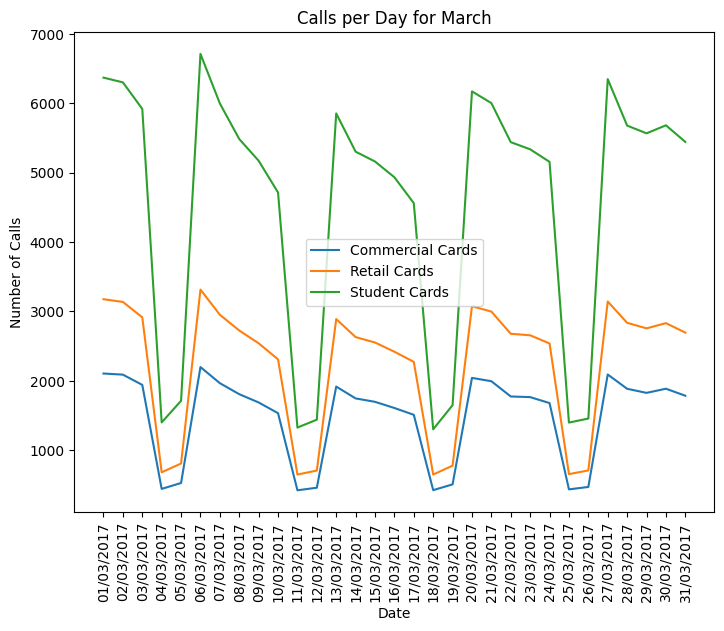

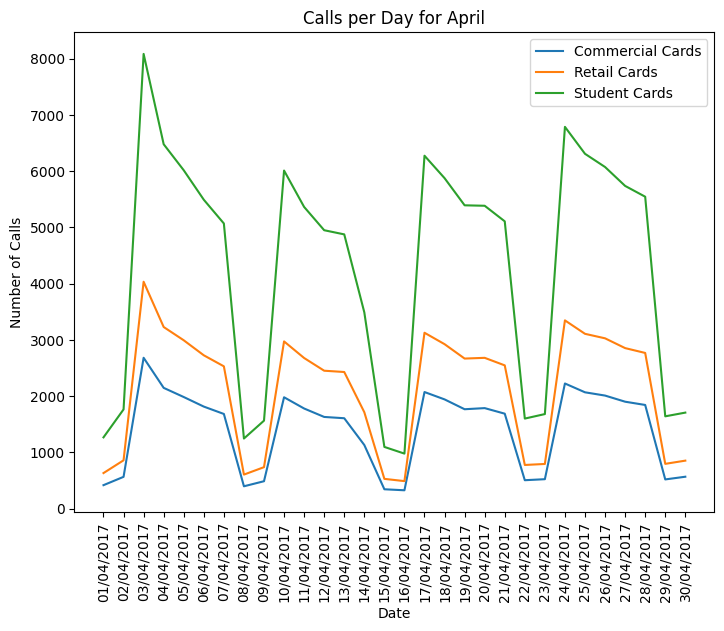

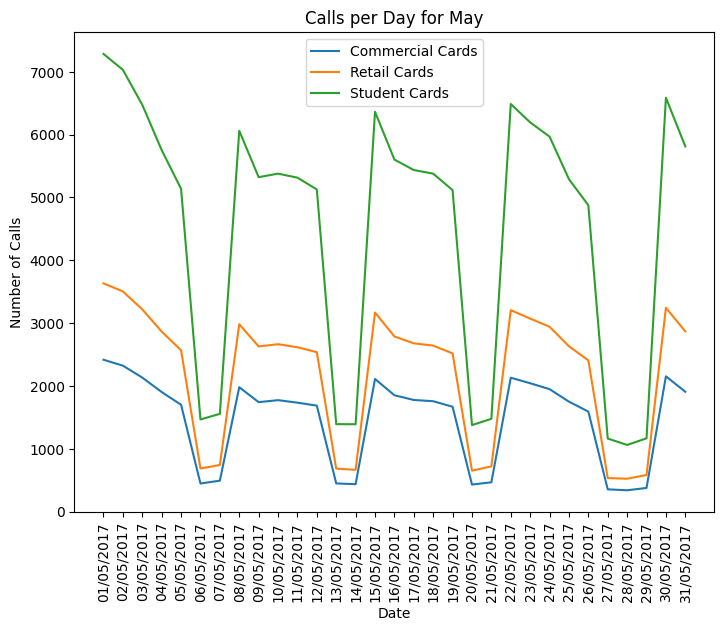

...

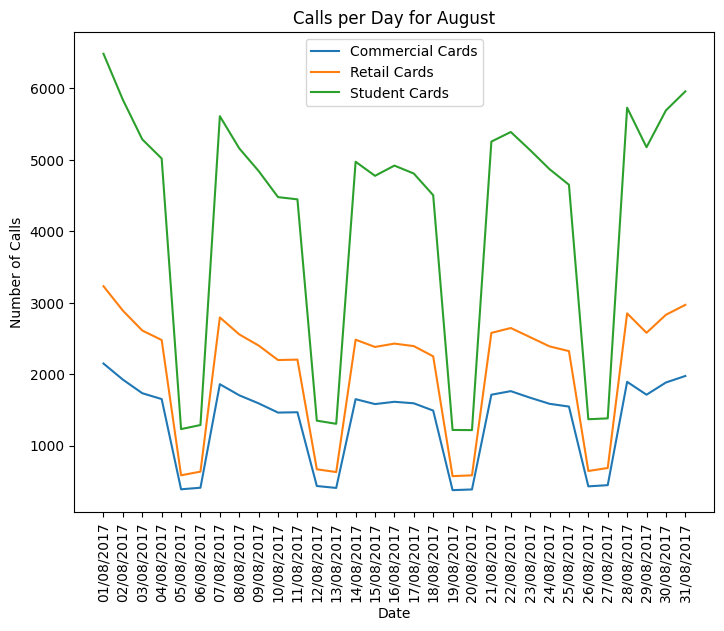

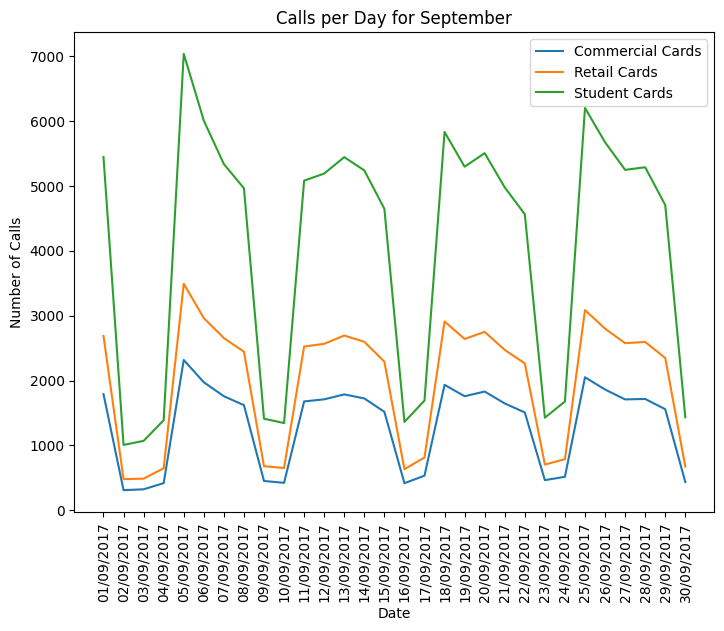

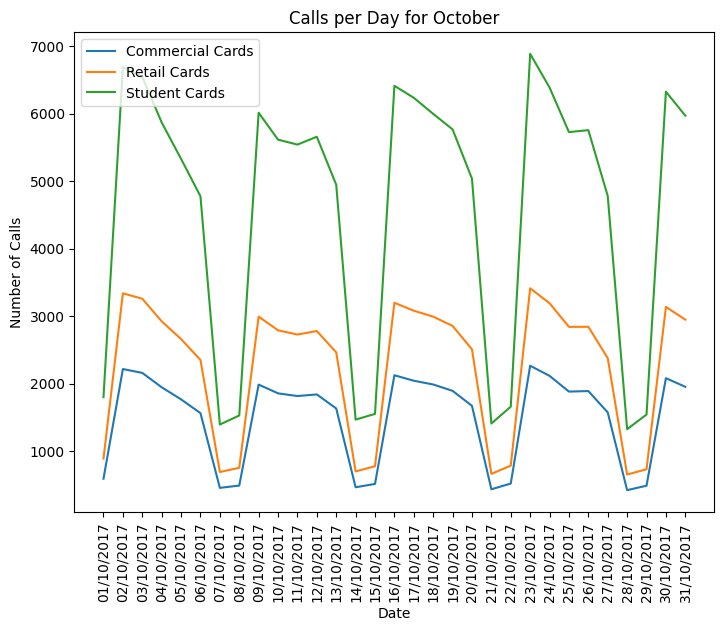

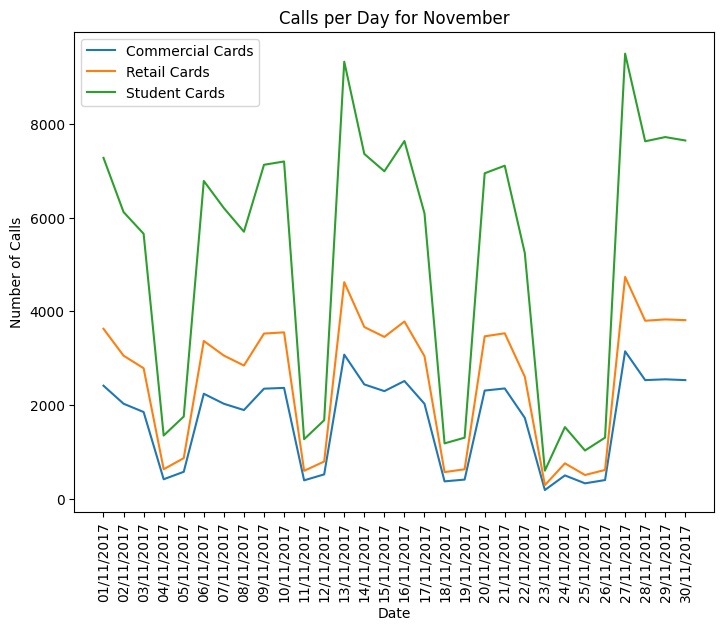

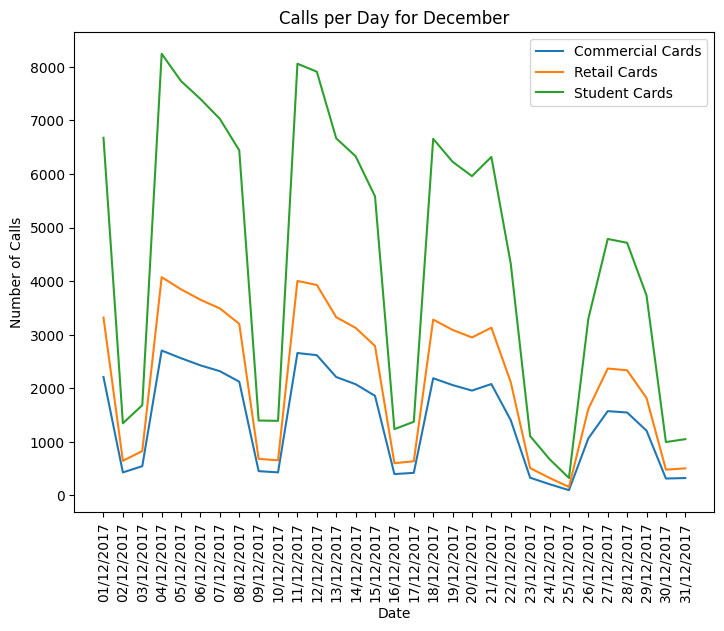

In [ ]:
# 2017 data for each month
# Low number of calls on weekends
# Low number of calls on Big Holidays
months = df_17.month.unique()
for m in months:
    x = range((df_17.month == m).sum())
    cc_values = df_17[df_17.month == m].cc
    rc_values = df_17[df_17.month == m].rc
    sc_values = df_17[df_17.month == m].sc
    fig = plt.figure()
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.set_xticks(x, df_17[df_17.month == m].date, rotation=90)
    ax.set_xlabel("Date")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')}")
    ax.legend()
    plt.show()

In [ ]:
# 2018-2021 Dataframe
df_not17 = df[df['year'] != 2017]

In [ ]:
df_not17.reset_index(drop=True, inplace=True)

In [ ]:
df_not17.head()

,date,cc,rc,sc,day,month,year
0,01/01/2018,200.0,305.0,709.0,1,1,2018
1,02/01/2018,3529.0,7136.0,2343.0,2,1,2018
2,03/01/2018,6862.0,2257.0,3404.0,3,1,2018
3,04/01/2018,2024.0,3036.0,6153.0,4,1,2018
4,05/01/2018,5934.0,1970.0,2961.0,5,1,2018


In [ ]:
# Sorting data according to trend -> (cc < rc < sc) for every day observed
df_not17_sorted = pd.DataFrame(columns=['date', 'cc', 'rc', 'sc', 'day', 'month', 'year'])
for index, row in df_not17.iterrows():
    values = sorted([row.cc, row.rc, row.sc])
    row_data = [row.date]
    row_data.extend(values)
    row_data.extend([row.day, row.month, row.year])
    df_not17_sorted.loc[index] = row_data

In [ ]:
df_not17_sorted.head()

,date,cc,rc,sc,day,month,year
0,01/01/2018,200.0,305.0,709.0,1,1,2018
1,02/01/2018,2343.0,3529.0,7136.0,2,1,2018
2,03/01/2018,2257.0,3404.0,6862.0,3,1,2018
3,04/01/2018,2024.0,3036.0,6153.0,4,1,2018
4,05/01/2018,1970.0,2961.0,5934.0,5,1,2018


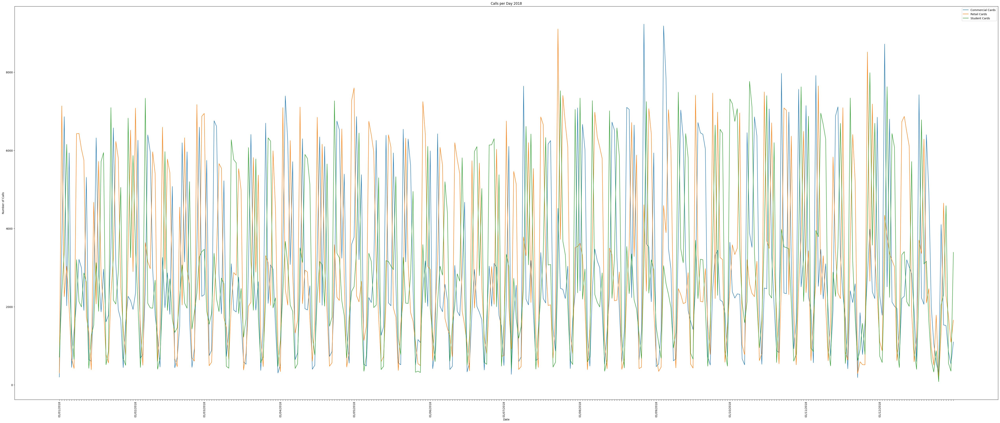

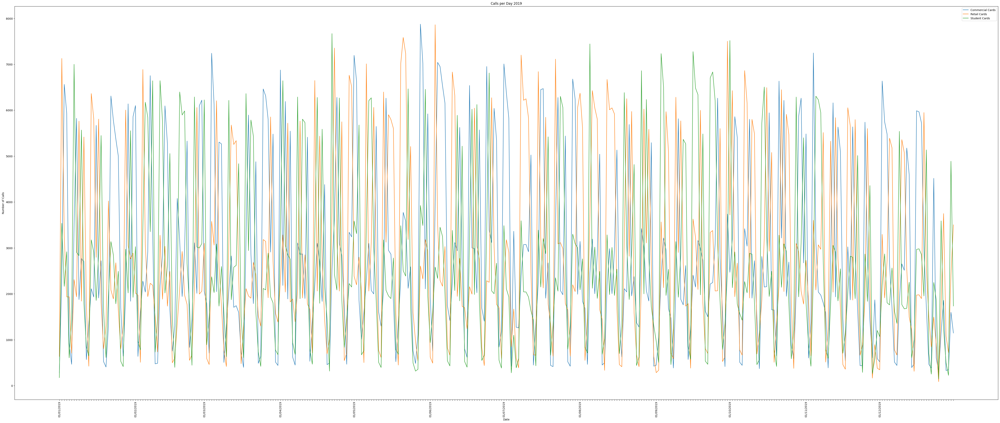

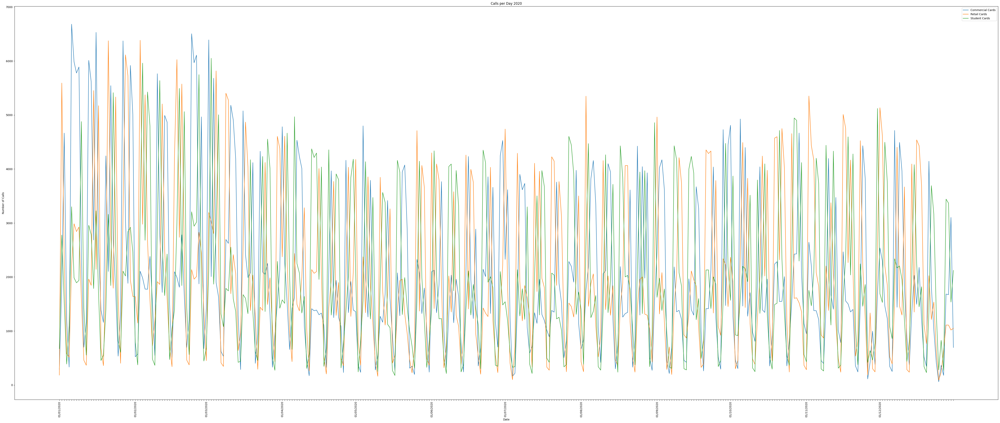

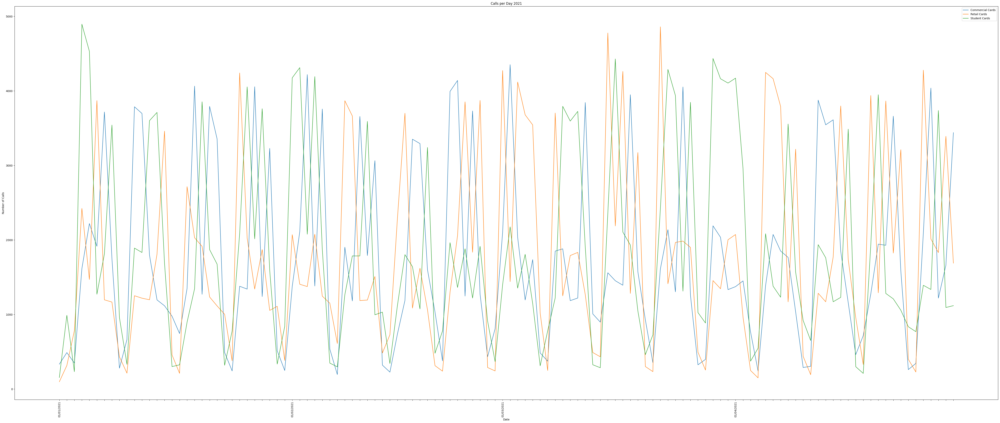

In [ ]:
# Plot unsorted data
years = df_not17.year.unique()
for y in years:
    x = range((df_not17['year'] == y).sum())
    cc_values = df_not17[df_not17.year == y].cc
    rc_values = df_not17[df_not17.year == y].rc
    sc_values = df_not17[df_not17.year == y].sc
    fig = plt.figure()
    fig.set_figheight(20)
    fig.set_figwidth(50)
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.set_xticks(x, [ dt if arrow.get(dt, "DD/MM/YYYY").day==1 else "" for dt in df_not17[df_not17.year == y]['date'] ], rotation=90)
    ax.set_xlabel("Date")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Day {y}")
    ax.legend()
    plt.show()

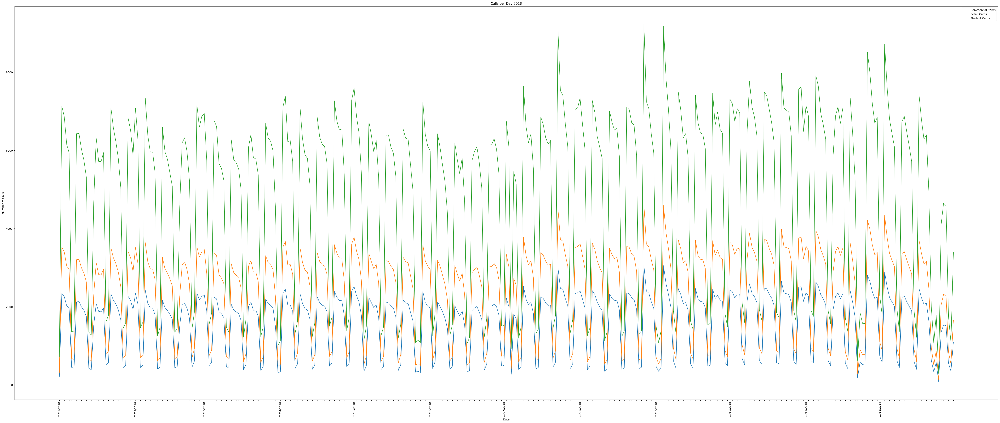

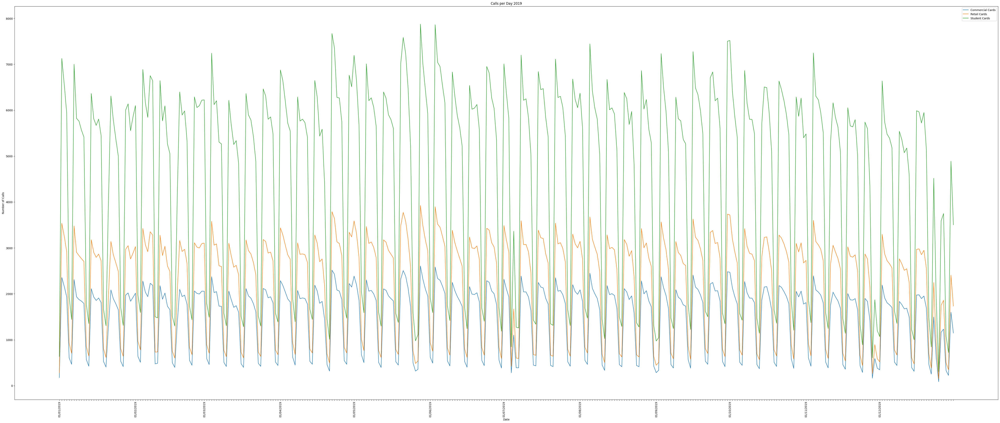

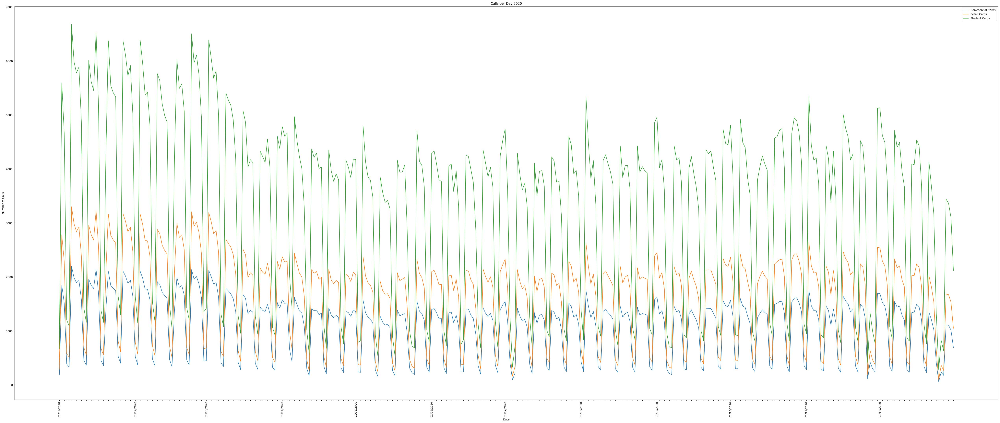

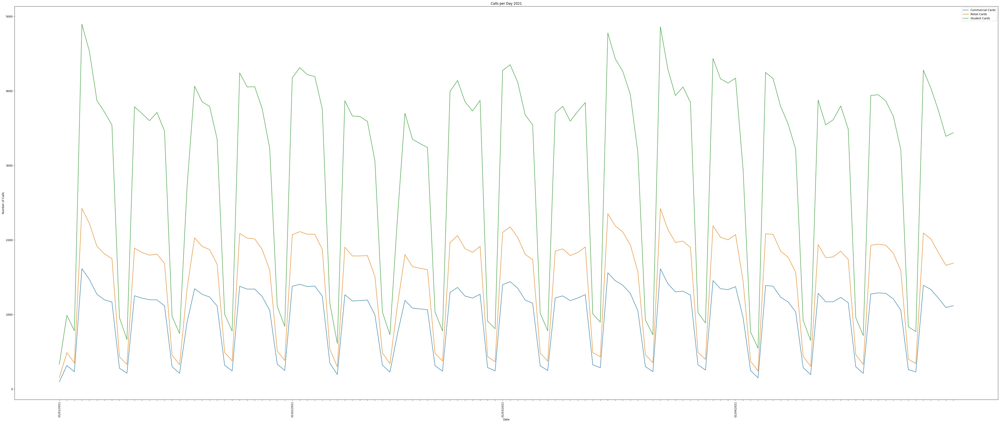

In [ ]:
# Plot sorted data
years = df_not17_sorted.year.unique()
for y in years:
    x = range((df_not17_sorted['year'] == y).sum())
    cc_values = df_not17_sorted[df_not17_sorted.year == y].cc
    rc_values = df_not17_sorted[df_not17_sorted.year == y].rc
    sc_values = df_not17_sorted[df_not17_sorted.year == y].sc
    fig = plt.figure()
    fig.set_figheight(20)
    fig.set_figwidth(50)
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.set_xticks(x, [ dt if arrow.get(dt, "DD/MM/YYYY").day==1 else "" for dt in df_not17_sorted[df_not17_sorted.year == y]['date'] ], rotation=90)
    ax.set_xlabel("Date")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Day {y}")
    ax.legend()
    plt.show()

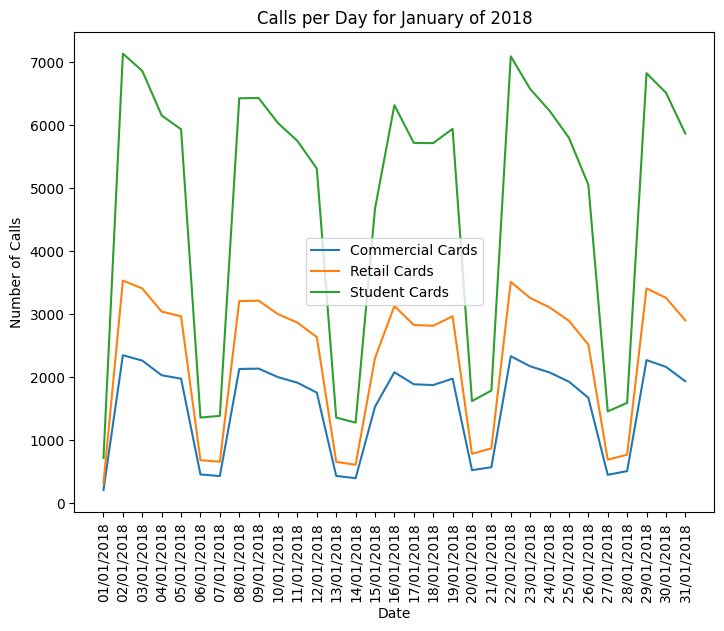

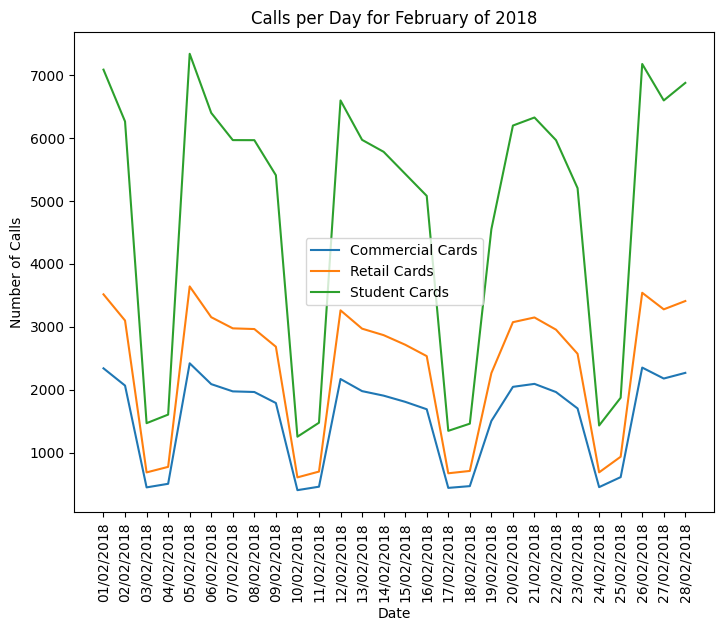

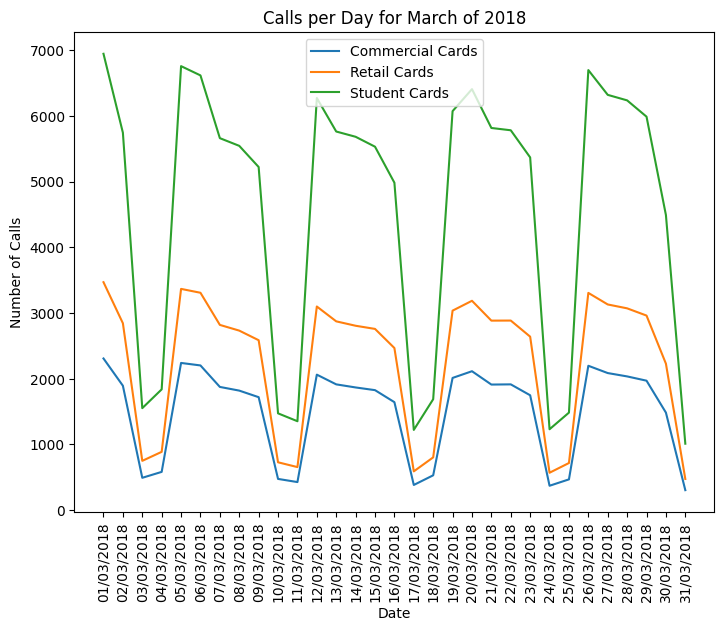

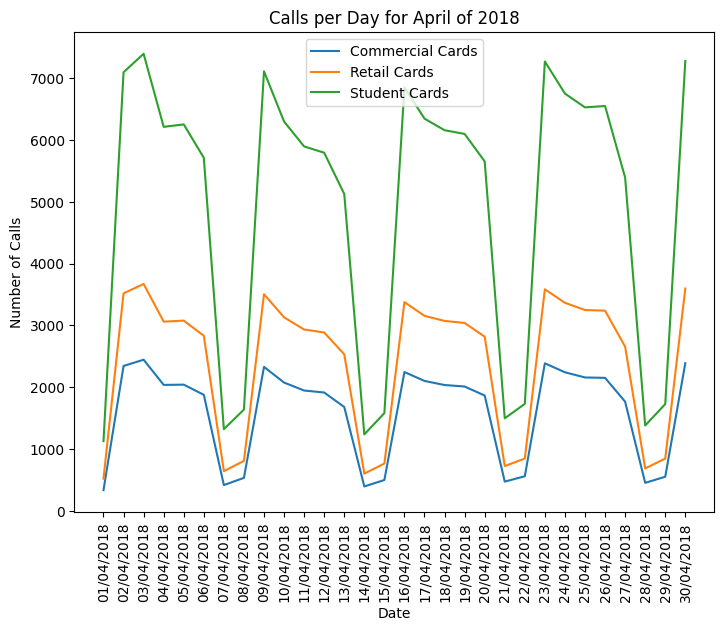

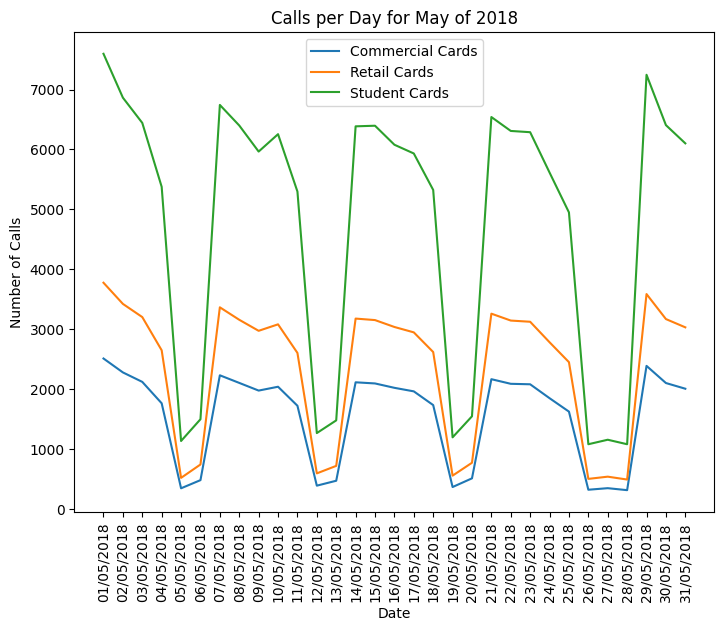

...

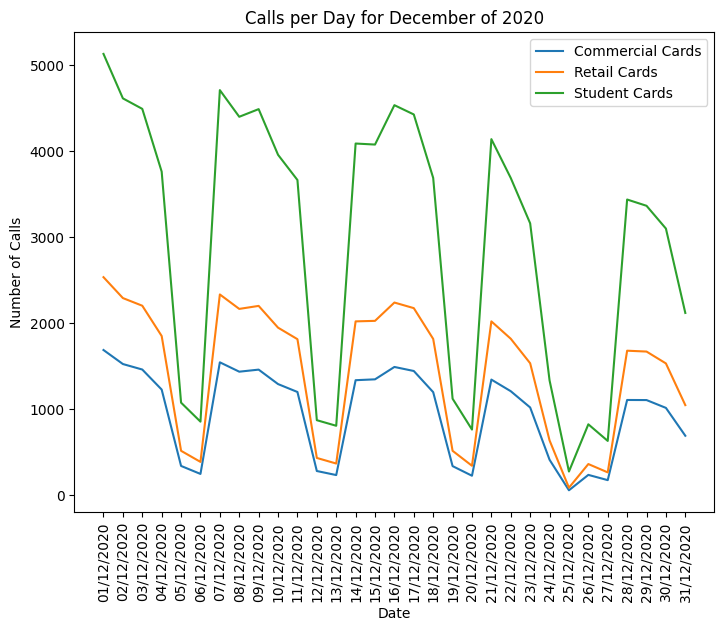

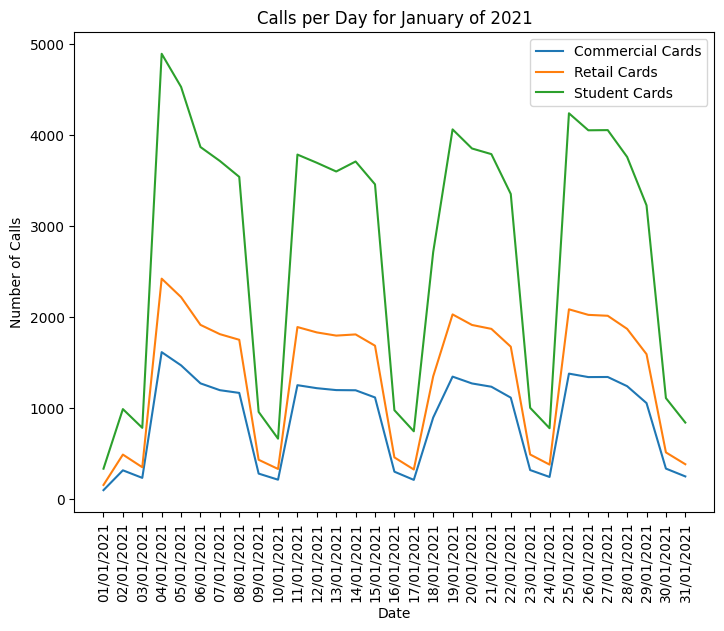

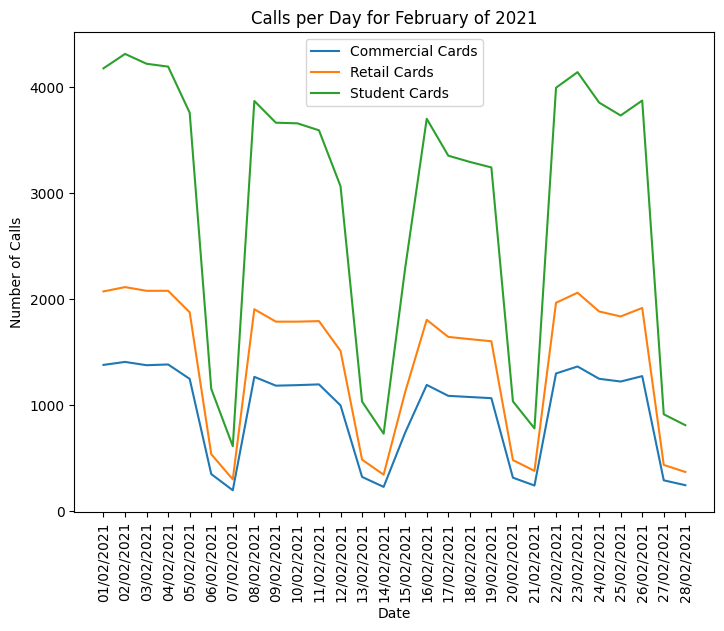

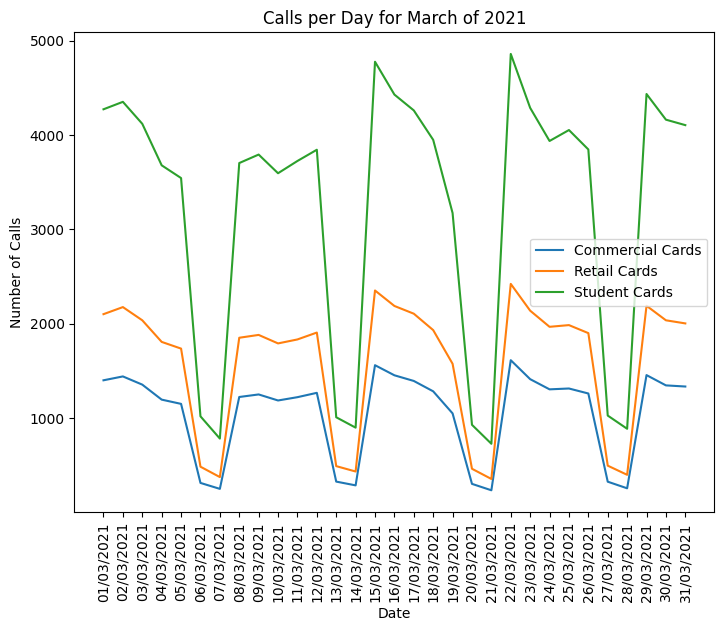

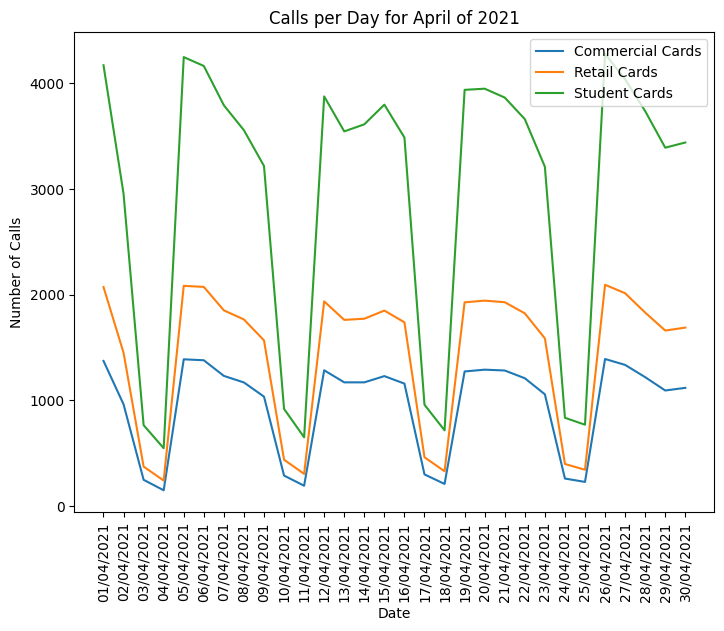

In [ ]:
# Plot monthly sorted data for every year 2018-2021
years = df_not17_sorted.year.unique()
for y in years:
    df_not17_sorted_yearly = df_not17_sorted[df_not17_sorted.year == y]
    months = df_not17_sorted_yearly.month.unique()
    for m in months:
        x = range((df_not17_sorted_yearly.month == m).sum())
        cc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].cc
        rc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].rc
        sc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].sc
        fig = plt.figure()
        ax = fig.add_axes([1,1,1,1])
        ax.plot(x, cc_values, label='Commercial Cards')
        ax.plot(x, rc_values, label='Retail Cards')
        ax.plot(x, sc_values, label='Student Cards')
        ax.set_xticks(x, df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].date, rotation=90)
        ax.set_xlabel("Date")
        ax.set_ylabel("Number of Calls")
        ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')} of {y}")
        ax.legend()
        plt.show()

In [ ]:
# Cumulative Montly Data
df_17_cumm = df_17[['cc', 'rc' , 'sc', 'month']].groupby('month').sum()

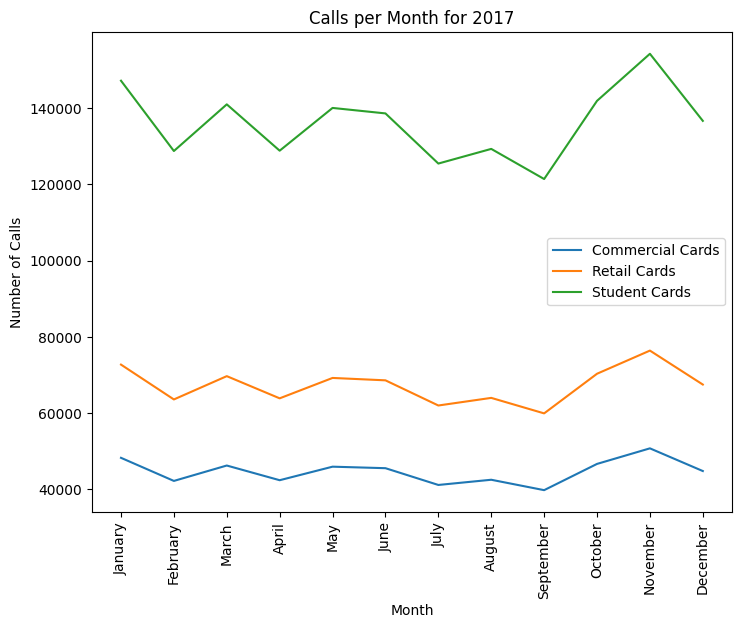

In [ ]:
# Plot Cumulative Monthly Data for 2017
x = range(len(df_17_cumm))
cc_values = df_17_cumm.cc
rc_values = df_17_cumm.rc
sc_values = df_17_cumm.sc
fig = plt.figure()
ax = fig.add_axes([1,1,1,1])
ax.plot(x, cc_values, label='Commercial Cards')
ax.plot(x, rc_values, label='Retail Cards')
ax.plot(x, sc_values, label='Student Cards')
ax.set_xticks(x, [ arrow.get(str(m), "M").format("MMMM") for m in df_17_cumm.index ], rotation=90)
ax.set_xlabel("Month")
ax.set_ylabel("Number of Calls")
ax.set_title(f"Calls per Month for 2017")
ax.legend()
plt.show()

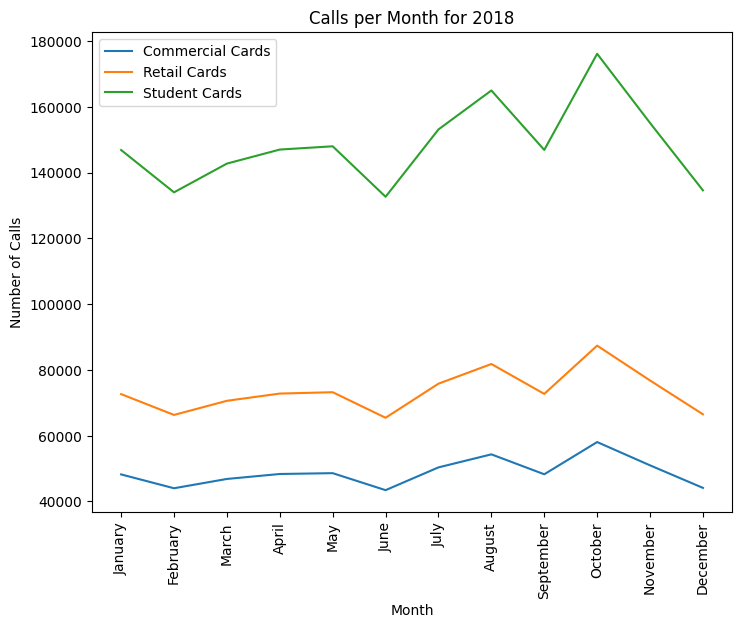

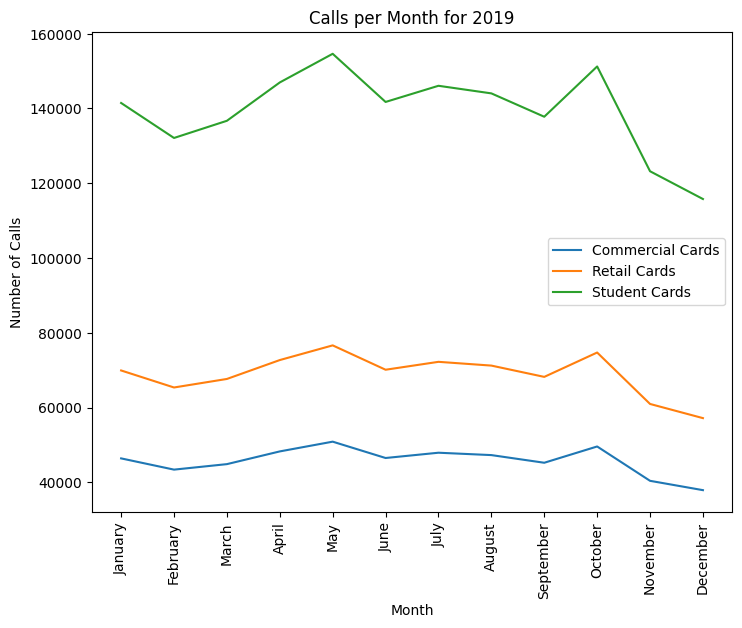

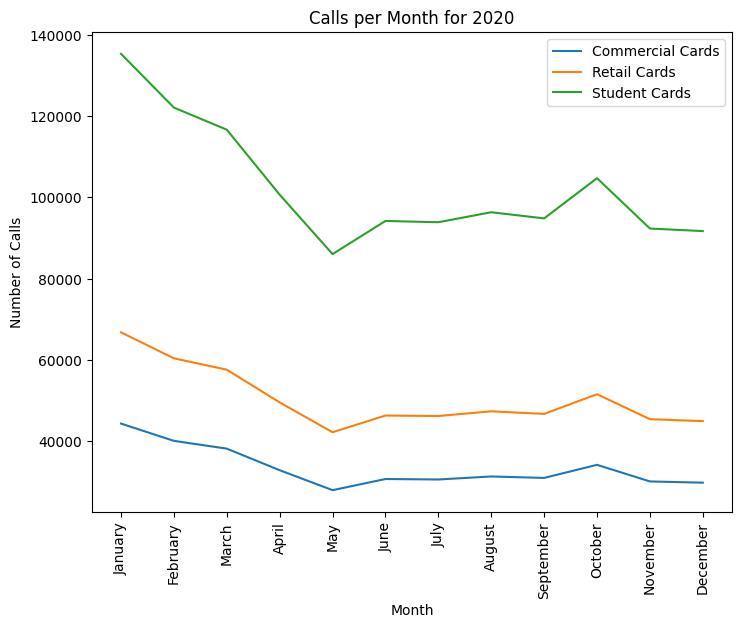

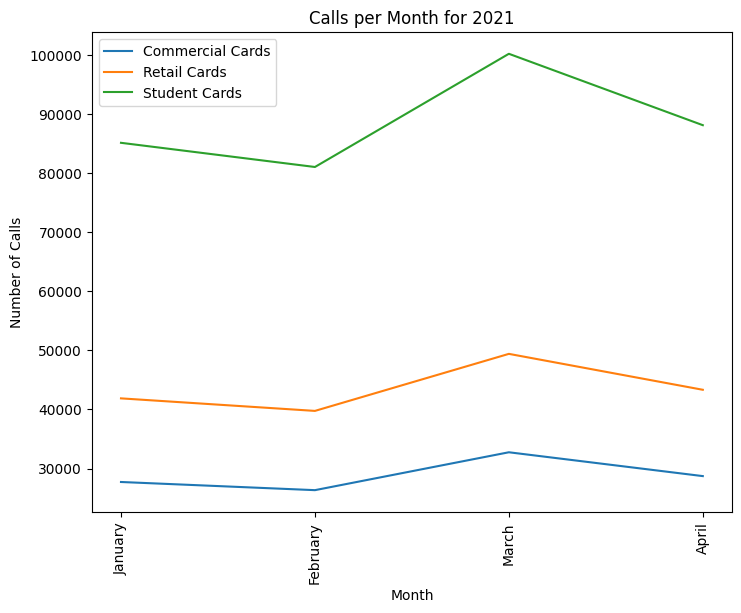

In [ ]:
# Plot Cumulative Monthly Data for 2018-2021
years = df_not17_sorted.year.unique()
for y in years:
    df_not17_sorted_yearly = df_not17_sorted[df_not17_sorted.year == y]
    df_cumm = df_not17_sorted_yearly[['cc', 'rc' , 'sc', 'month']].groupby('month').sum()
    x = range(len(df_cumm))
    cc_values = df_cumm.cc
    rc_values = df_cumm.rc
    sc_values = df_cumm.sc
    fig = plt.figure()
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.set_xticks(x, [ arrow.get(str(m), "M").format("MMMM") for m in df_cumm.index ], rotation=90)
    ax.set_xlabel("Month")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Month for {y}")
    ax.legend()
    plt.show()

In [ ]:
# Add US Fedrarl Holidays
cal = USFederalHolidayCalendar()
holidays_series = cal.holidays(start='2017-01-01', end='2021-04-30', return_name=True)
holidays = holidays_series.to_frame("name")
holidays.reset_index(inplace=True)
holidays.rename(columns={"index":"date"}, inplace=True)

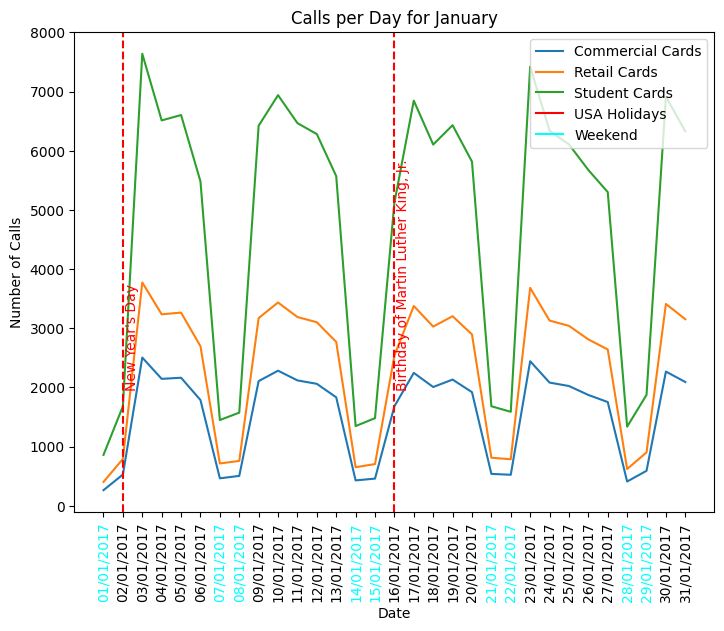

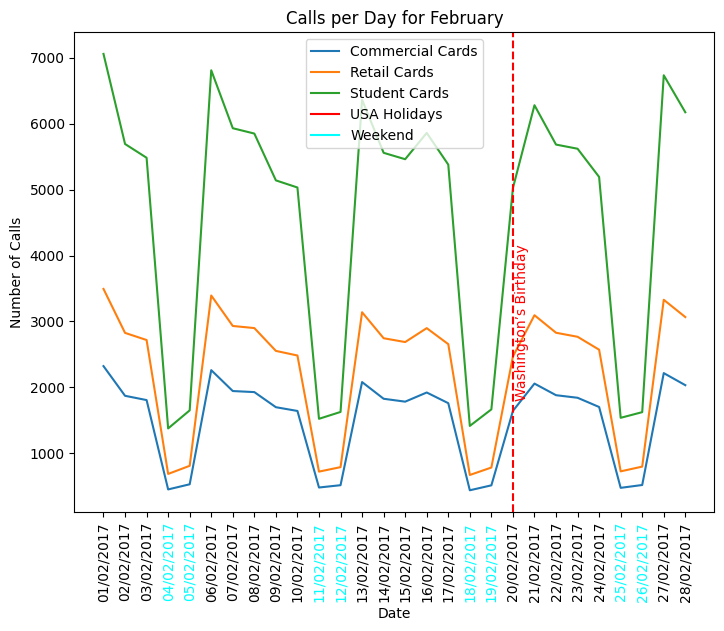

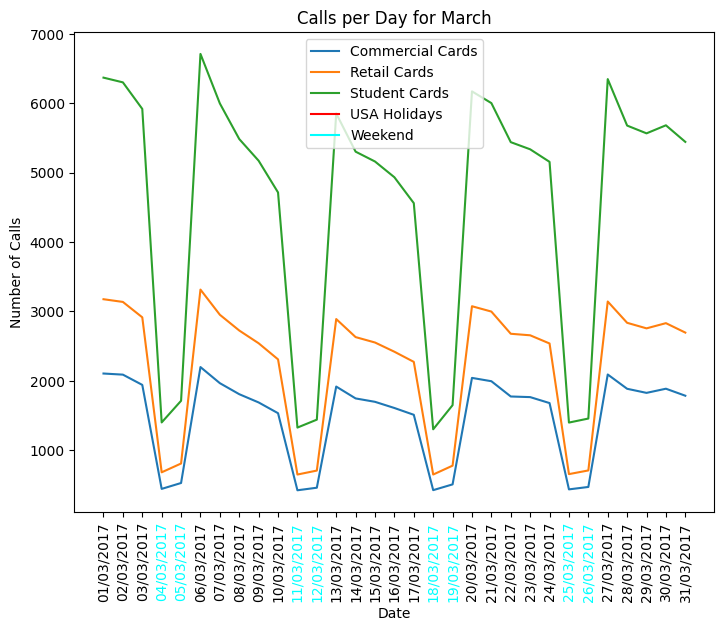

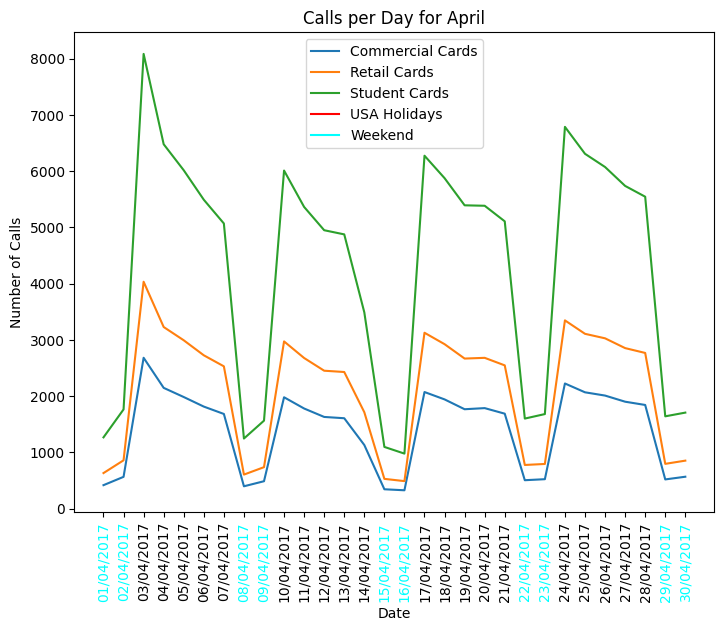

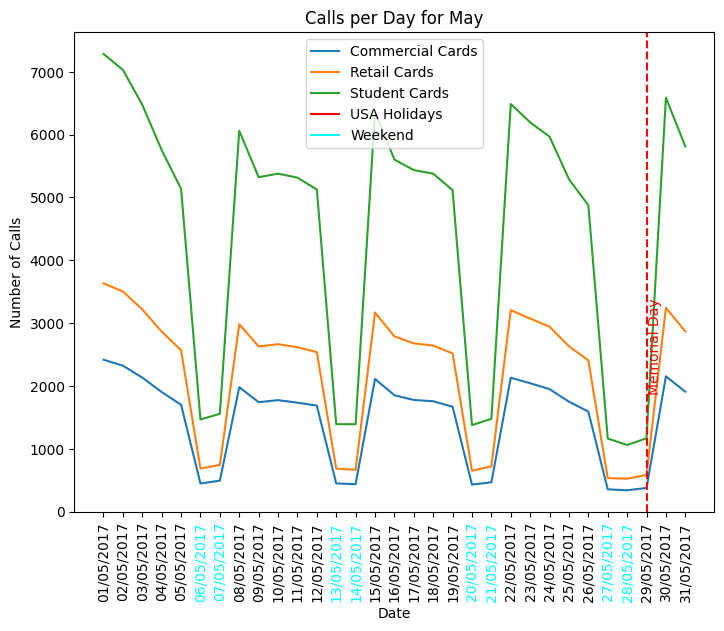

...

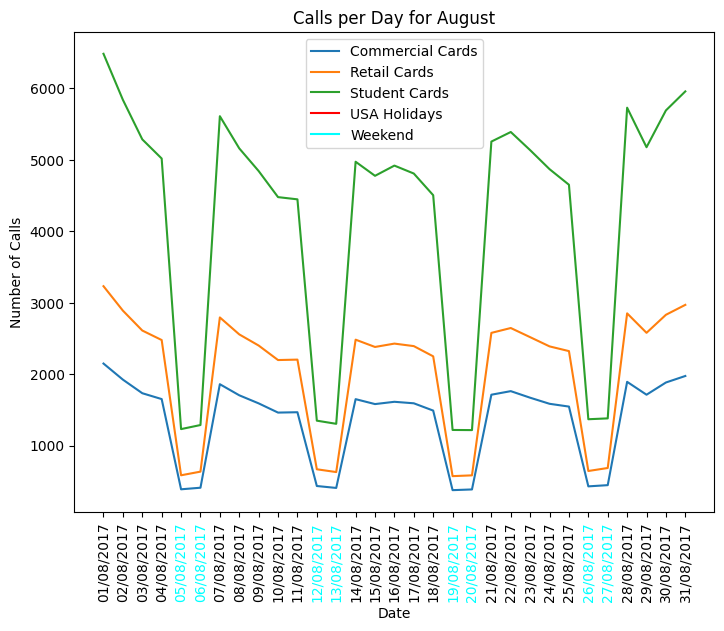

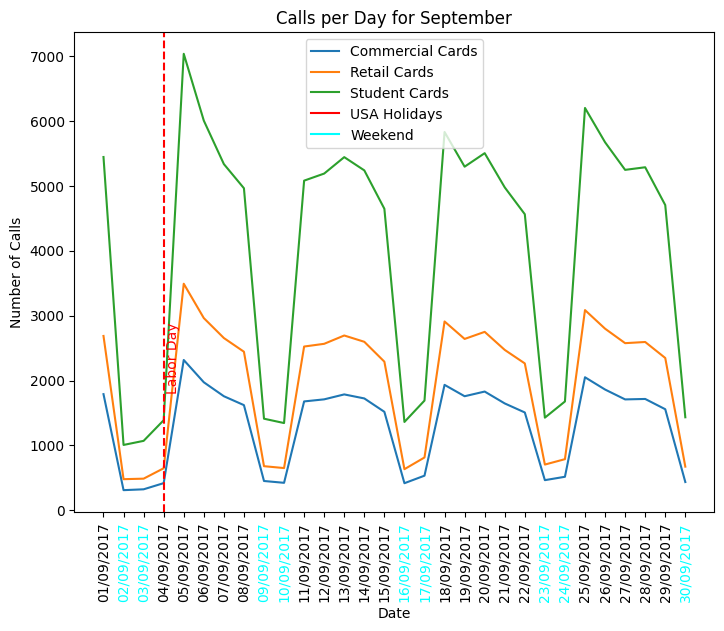

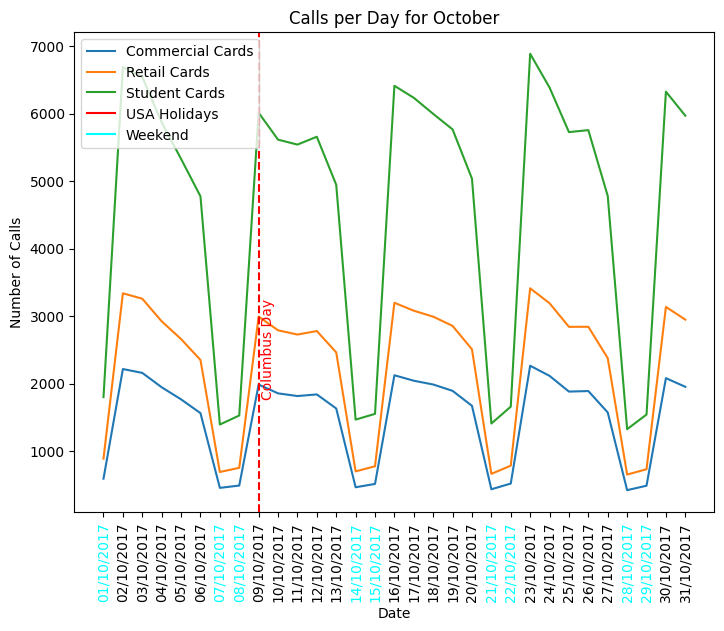

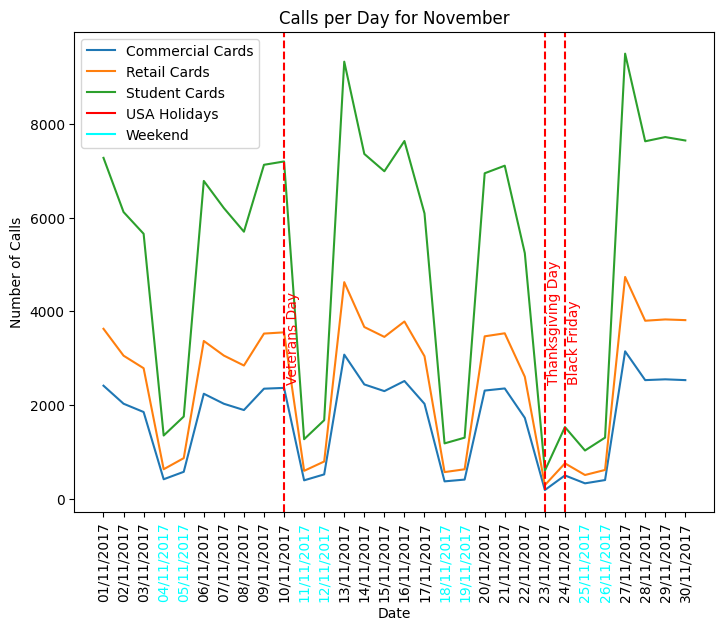

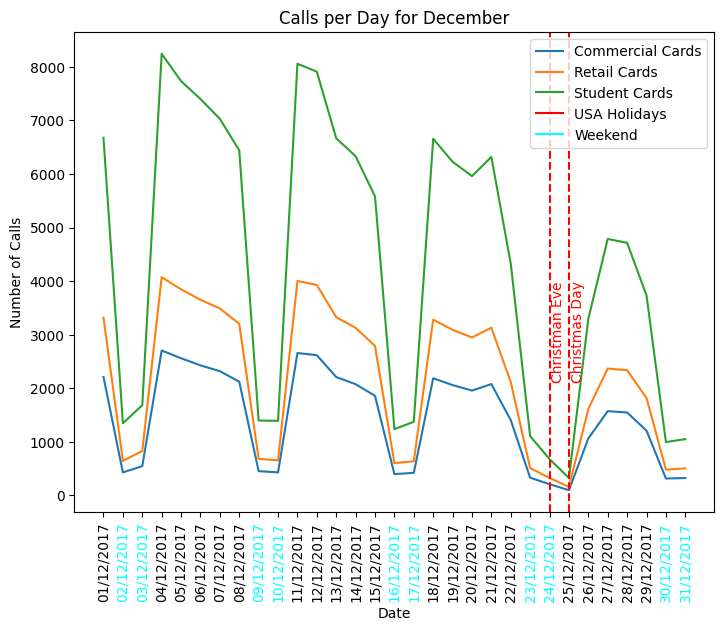

In [ ]:
# 2017 data for each month
# Low number of calls on weekends
# Low number of calls on Big Holidays
holidays_2017 = holidays[[True if dt.year == 2017 else False for dt in holidays.date]]
months = df_17.month.unique()
for m in months:
    x = range((df_17.month == m).sum())
    cc_values = df_17[df_17.month == m].cc
    rc_values = df_17[df_17.month == m].rc
    sc_values = df_17[df_17.month == m].sc
    month_holidays = holidays_2017[[True if dt.month == m else False for dt in holidays_2017.date]]
    monhol_values = [(dt.date.day-1, dt['name']) for i, dt in month_holidays.iterrows()]
    fig = plt.figure()
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.plot([], [], label='USA Holidays', c='red')
    ax.plot([], [], label='Weekend', c='cyan')
    for mhd, mhn in monhol_values:
        if mhn == 'Thanksgiving Day':
            ax.axvline(mhd+1, c='red', ls='--')
            ax.text(mhd+1.1, ax.get_ylim()[1]//4, "Black Friday", rotation=90, c='red')
        if mhn == 'Christmas Day':
            ax.axvline(mhd-1, c='red', ls='--')
            ax.text(mhd-0.9, ax.get_ylim()[1]//4, "Christman Eve", rotation=90, c='red')
        ax.axvline(mhd, c='red', ls='--')
        ax.text(mhd+0.1, ax.get_ylim()[1]//4, mhn, rotation=90, c='red')
    ax.set_xticks(x, df_17[df_17.month == m].date, rotation=90)
    for i, dt in enumerate(df_17[df_17.month == m].date):
        if arrow.get(dt, "DD/MM/YYYY").format("ddd") in ["Sat", "Sun"]:
            ax.get_xticklabels()[i].set_color('cyan')
    ax.set_xlabel("Date")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')}")
    ax.legend()
    plt.show()

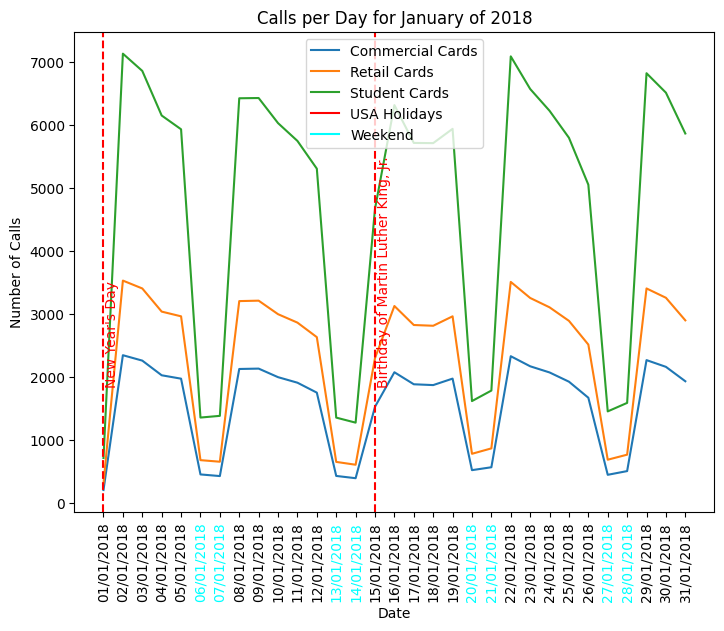

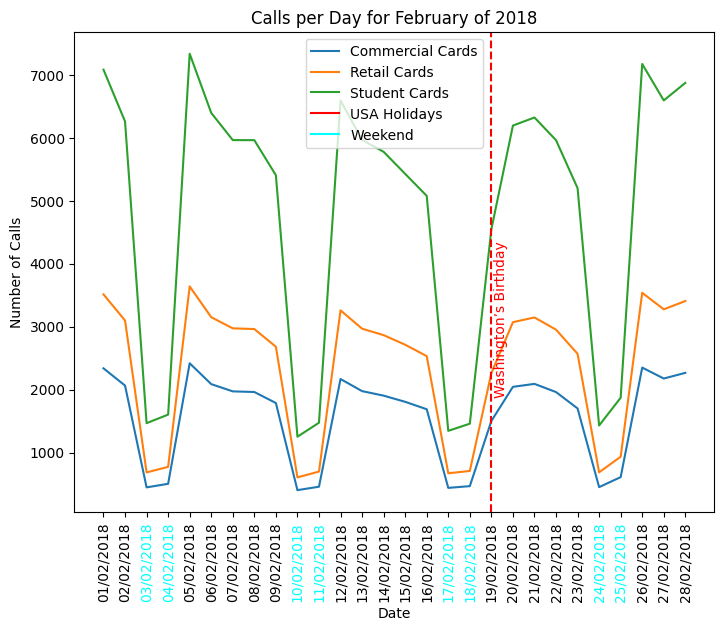

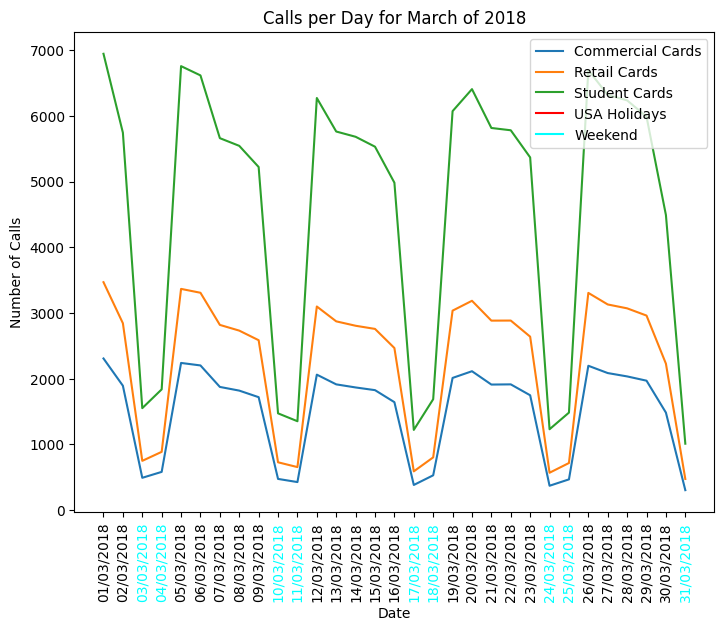

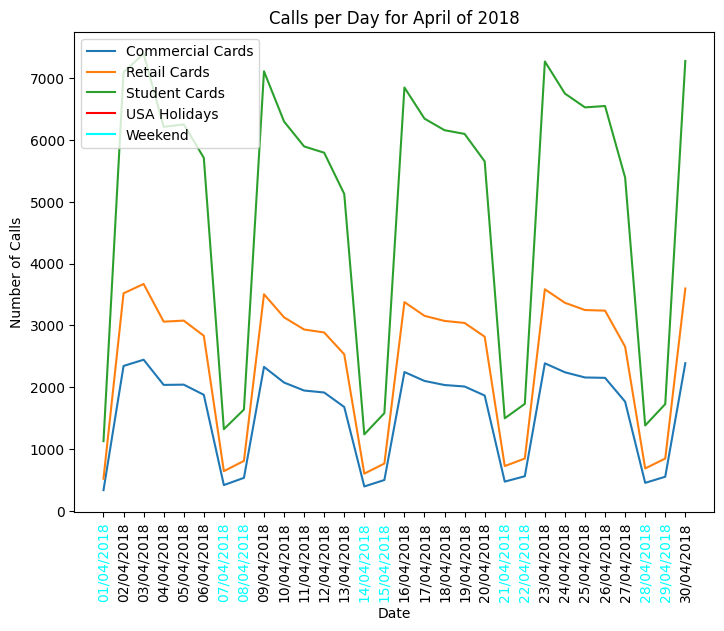

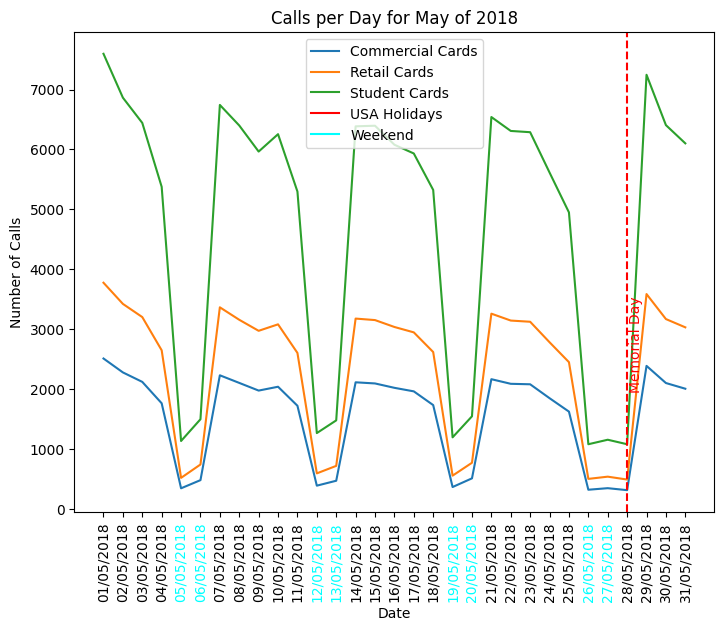

...

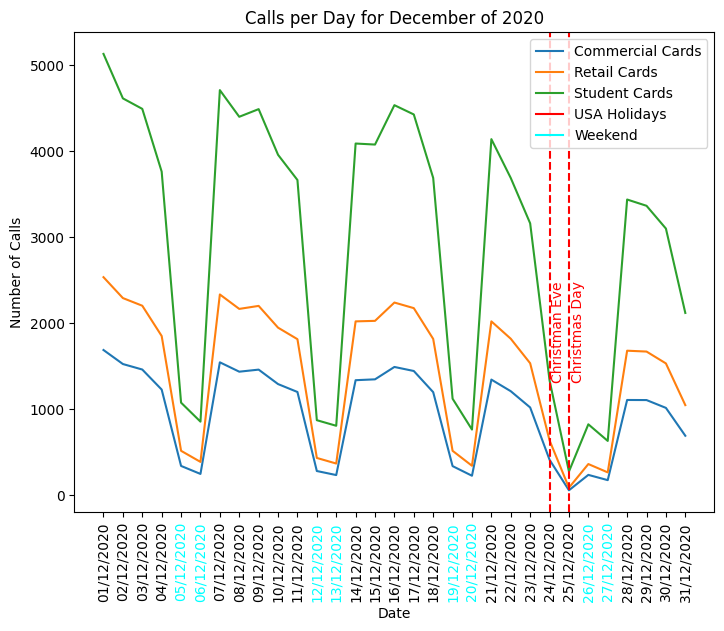

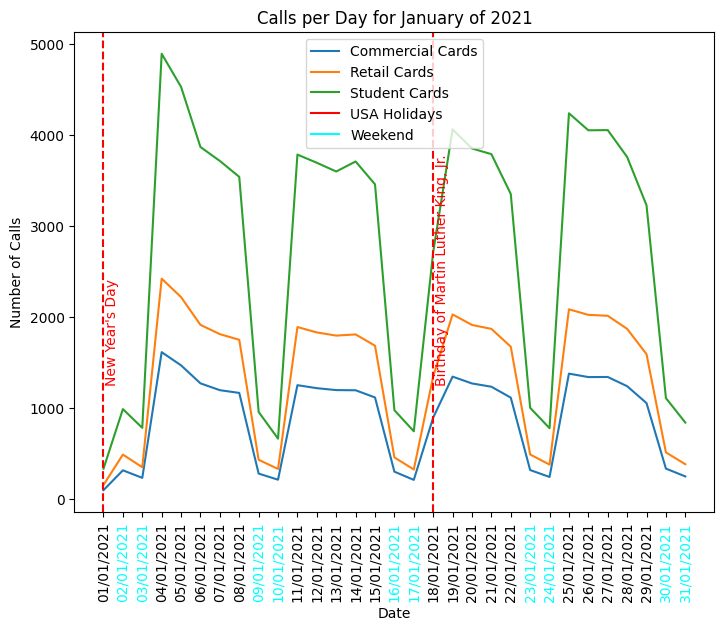

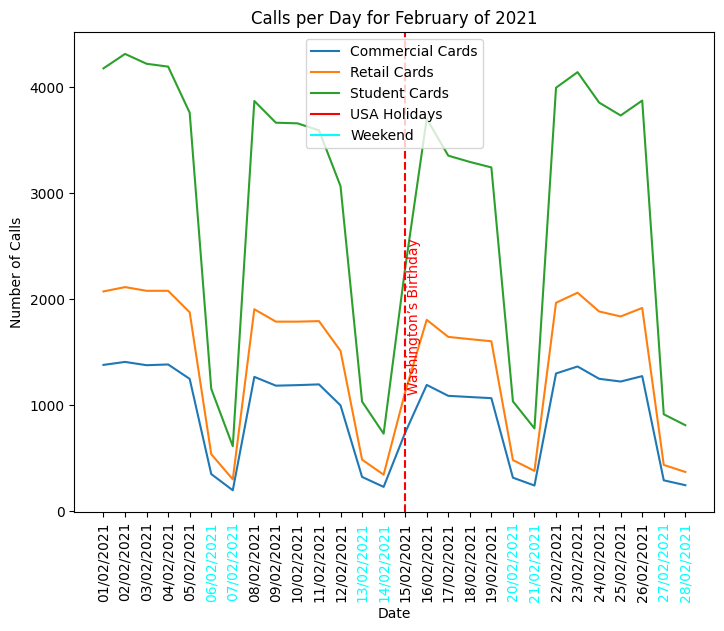

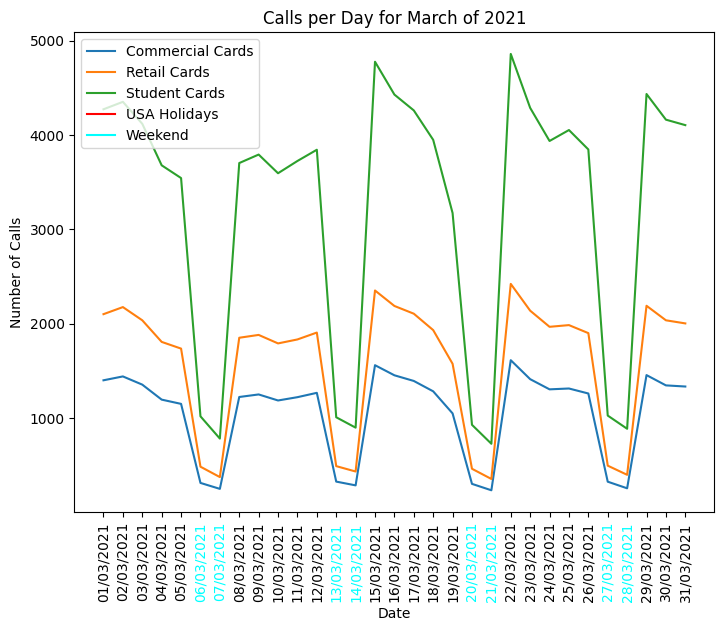

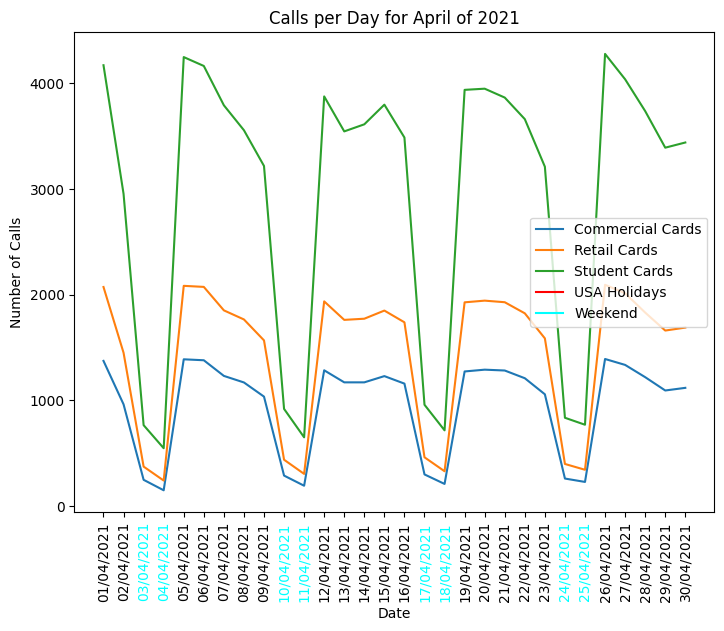

In [ ]:
# 2018-2021 data for each month
# Low number of calls on weekends
# Low number of calls on Big Holidays
years = df_not17_sorted.year.unique()
for y in years:
    holidays_yearly = holidays[[True if dt.year == y else False for dt in holidays.date]]
    df_not17_sorted_yearly = df_not17_sorted[df_not17_sorted.year == y]
    months = df_not17_sorted_yearly.month.unique()
    for m in months:
        x = range((df_not17_sorted_yearly.month == m).sum())
        cc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].cc
        rc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].rc
        sc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].sc
        month_holidays = holidays_yearly[[True if dt.month == m else False for dt in holidays_yearly.date]]
        monhol_values = [(dt.date.day-1, dt['name']) for i, dt in month_holidays.iterrows()]
        fig = plt.figure()
        ax = fig.add_axes([1,1,1,1])
        ax.plot(x, cc_values, label='Commercial Cards')
        ax.plot(x, rc_values, label='Retail Cards')
        ax.plot(x, sc_values, label='Student Cards')
        ax.plot([], [], label='USA Holidays', c='red')
        ax.plot([], [], label='Weekend', c='cyan')
        for mhd, mhn in monhol_values:
            if mhn == 'Thanksgiving Day':
                ax.axvline(mhd+1, c='red', ls='--')
                ax.text(mhd+1.1, ax.get_ylim()[1]//4, "Black Friday", rotation=90, c='red')
            if mhn == 'Christmas Day':
                ax.axvline(mhd-1, c='red', ls='--')
                ax.text(mhd-0.9, ax.get_ylim()[1]//4, "Christman Eve", rotation=90, c='red')
            ax.axvline(mhd, c='red', ls='--')
            ax.text(mhd+0.1, ax.get_ylim()[1]//4, mhn, rotation=90, c='red')
        ax.set_xticks(x, df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].date, rotation=90)
        for i, dt in enumerate(df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].date):
            if arrow.get(dt, "DD/MM/YYYY").format("ddd") in ["Sat", "Sun"]:
                ax.get_xticklabels()[i].set_color('cyan')
        ax.set_xlabel("Date")
        ax.set_ylabel("Number of Calls")
        ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')} of {y}")
        ax.legend()
        plt.show()

In [ ]:
# Manila Holiday Calendar
class idcalen(AbstractHolidayCalendar):
    rules=[
        Holiday("New Year",month=1,day=1),
        Holiday("Day of Valor",month=4,day=9),
        Holiday("Labor Day",month=5,day=1),
        Holiday("Independence Day",month=6,day=12),
        Holiday("National heroes day",month=8,day=31,offset=pd.DateOffset(weekday=MO(-1))),
        Holiday("Bonifacio",month=11,day=30),
        Holiday("Christmas",month=12,day=25),
        Holiday("Rizal",month=12,day=30),
        Holiday("Maundy Thursday",month=4,day=13,year=2017),
        Holiday("Maundy Thursday",month=3,day=29,year=2018),
        Holiday("Maundy Thursday",month=4,day=18,year=2019),
        Holiday("Maundy Thursday",month=4,day=9,year=2020),
        Holiday("Maundy Thursday",month=4,day=1,year=2021),
        Holiday("Good Friday",month=4,day=14,year=2017),
        Holiday("Good Friday",month=3,day=30,year=2018),
        Holiday("Good Friday",month=4,day=19,year=2019),
        Holiday("Good Friday",month=4,day=10,year=2020),
        Holiday("Good Friday",month=4,day=2,year=2021)
    ]

In [ ]:
manila_cal=idcalen()
manila_holidays = manila_cal.holidays(start="2017-01-01",end="2021-04-30",return_name=True)
m_holidays = manila_holidays.to_frame("name")
m_holidays.reset_index(inplace=True)
m_holidays.rename(columns={"index":"date"}, inplace=True)

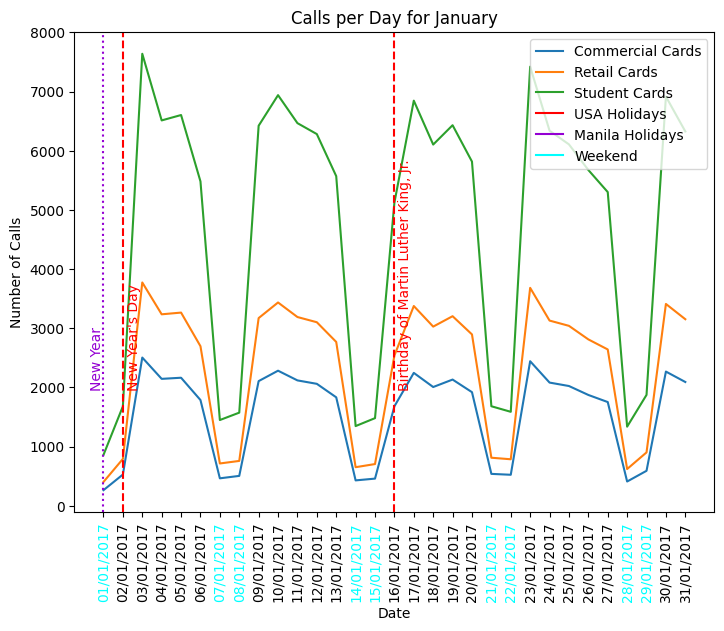

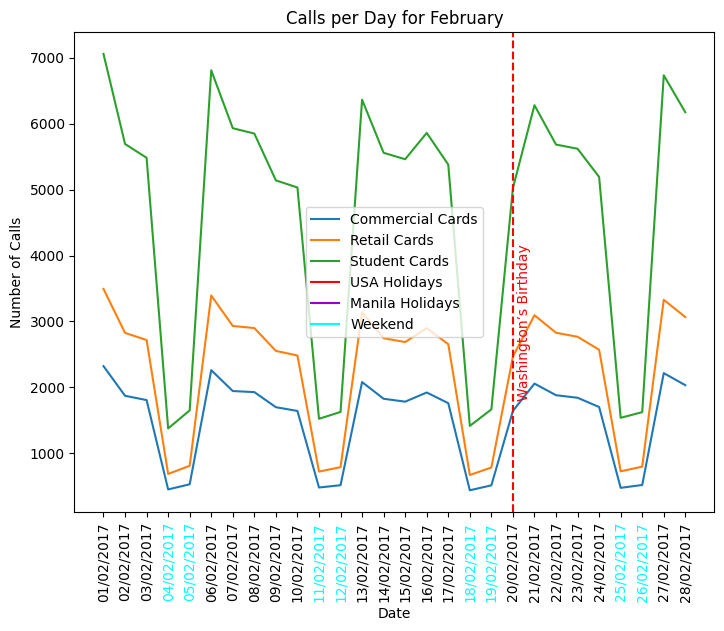

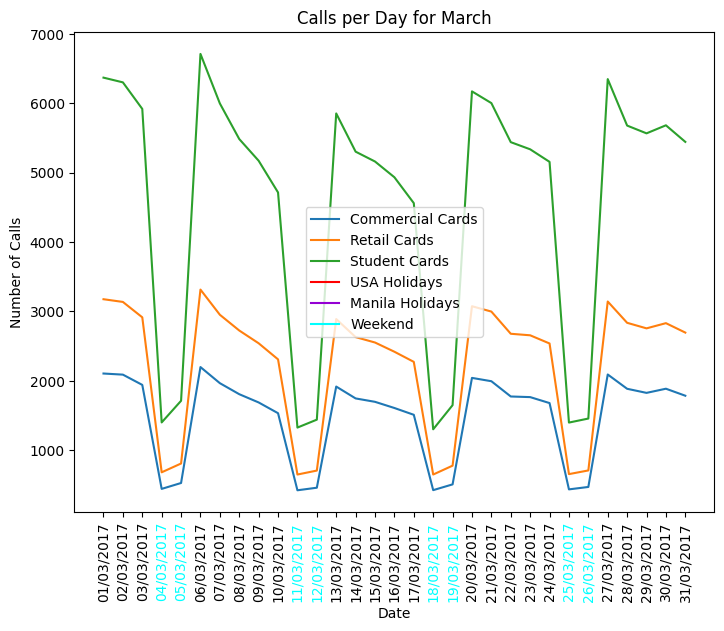

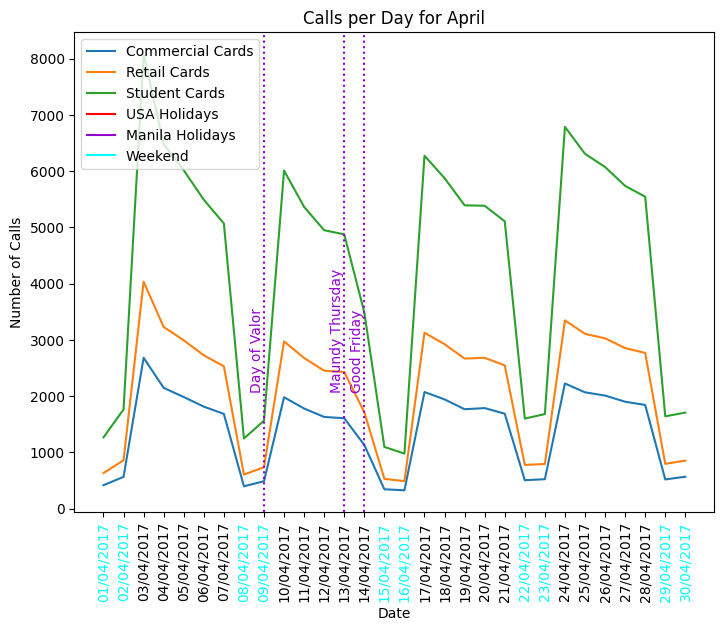

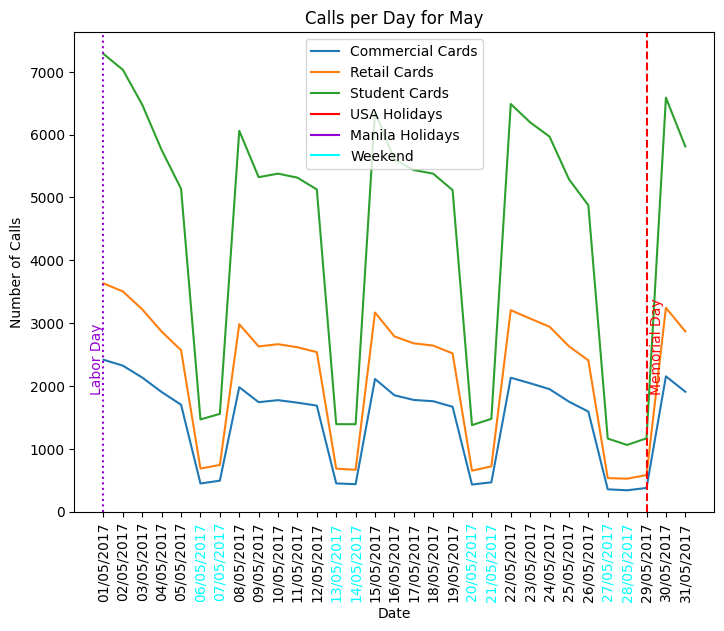

...

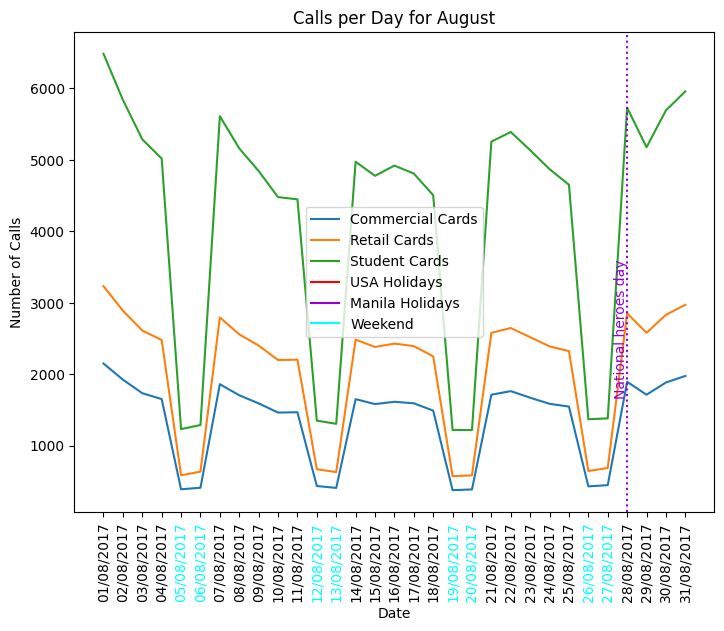

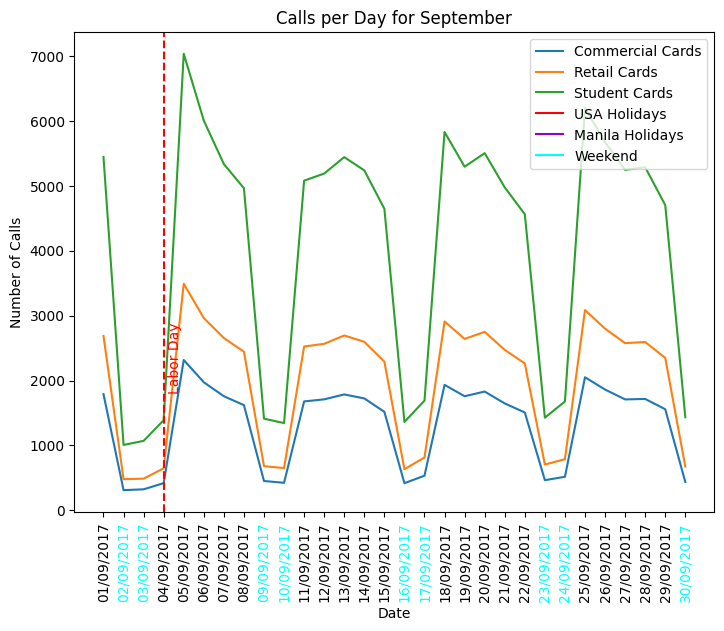

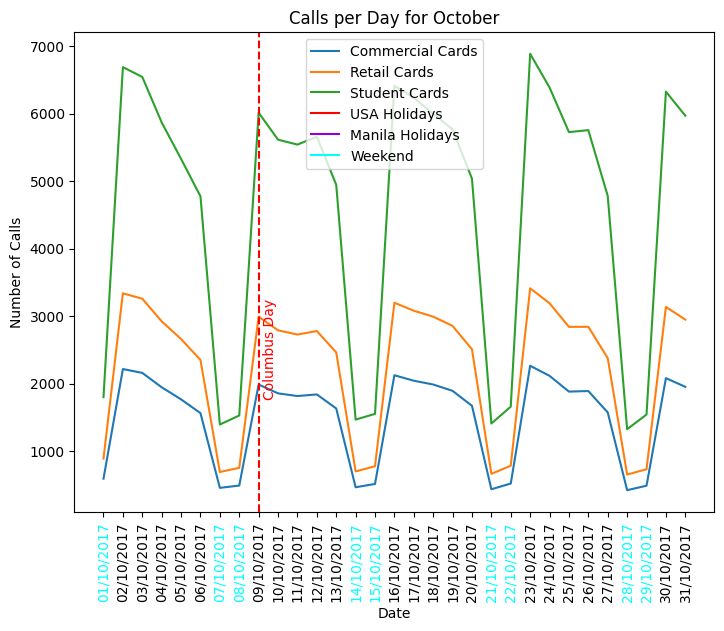

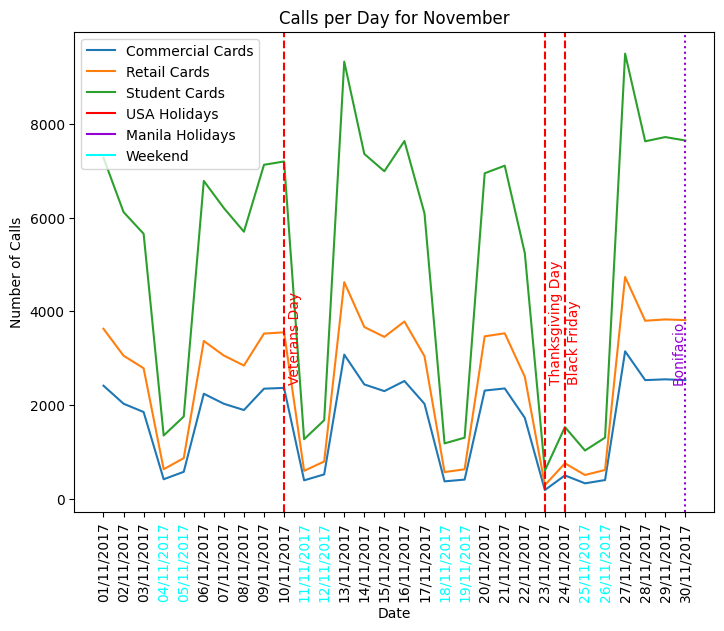

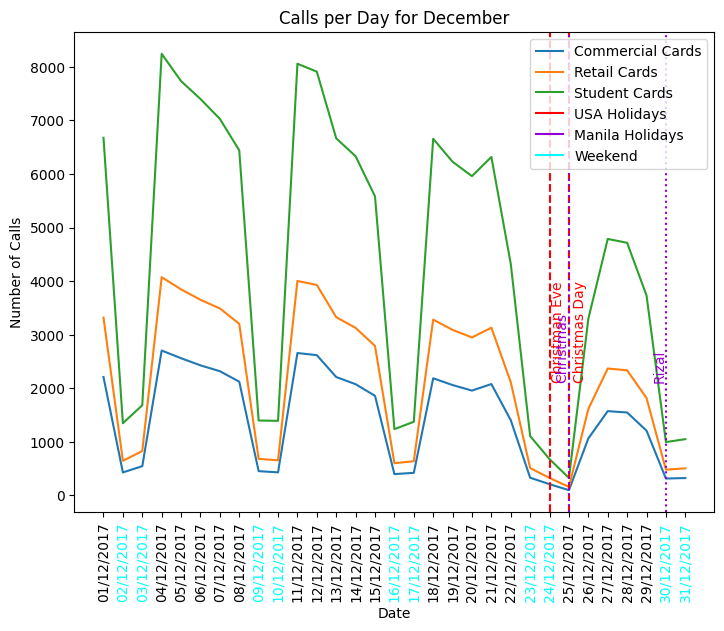

In [ ]:
# 2017 data for each month
# Low number of calls on weekends
# Low number of calls on Big Holidays
holidays_2017 = holidays[[True if dt.year == 2017 else False for dt in holidays.date]]
m_holidays_2017 = m_holidays[[True if dt.year == 2017 else False for dt in m_holidays.date]]
months = df_17.month.unique()
for m in months:
    x = range((df_17.month == m).sum())
    cc_values = df_17[df_17.month == m].cc
    rc_values = df_17[df_17.month == m].rc
    sc_values = df_17[df_17.month == m].sc
    month_holidays = holidays_2017[[True if dt.month == m else False for dt in holidays_2017.date]]
    monhol_values = [(dt.date.day-1, dt['name']) for i, dt in month_holidays.iterrows()]
    m_month_holidays = m_holidays_2017[[True if dt.month == m else False for dt in m_holidays_2017.date]]
    m_monhol_values = [(dt.date.day-1, dt['name']) for i, dt in m_month_holidays.iterrows()]
    fig = plt.figure()
    ax = fig.add_axes([1,1,1,1])
    ax.plot(x, cc_values, label='Commercial Cards')
    ax.plot(x, rc_values, label='Retail Cards')
    ax.plot(x, sc_values, label='Student Cards')
    ax.plot([], [], label='USA Holidays', c='red')
    ax.plot([], [], label='Manila Holidays', c='darkviolet')
    ax.plot([], [], label='Weekend', c='cyan')
    for mhd, mhn in monhol_values:
        if mhn == 'Thanksgiving Day':
            ax.axvline(mhd+1, c='red', ls='--')
            ax.text(mhd+1.1, ax.get_ylim()[1]//4, "Black Friday", rotation=90, c='red')
        if mhn == 'Christmas Day':
            ax.axvline(mhd-1, c='red', ls='--')
            ax.text(mhd-0.9, ax.get_ylim()[1]//4, "Christman Eve", rotation=90, c='red')
        ax.axvline(mhd, c='red', ls='--')
        ax.text(mhd+0.2, ax.get_ylim()[1]//4, mhn, rotation=90, c='red')
    for mhd, mhn in m_monhol_values:
        ax.axvline(mhd, c='darkviolet', ls=':')
        ax.text(mhd-0.7, ax.get_ylim()[1]//4, mhn, rotation=90, c='darkviolet')
    ax.set_xticks(x, df_17[df_17.month == m].date, rotation=90)
    for i, dt in enumerate(df_17[df_17.month == m].date):
        if arrow.get(dt, "DD/MM/YYYY").format("ddd") in ["Sat", "Sun"]:
            ax.get_xticklabels()[i].set_color('cyan')
    ax.set_xlabel("Date")
    ax.set_ylabel("Number of Calls")
    ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')}")
    ax.legend()
    plt.show()

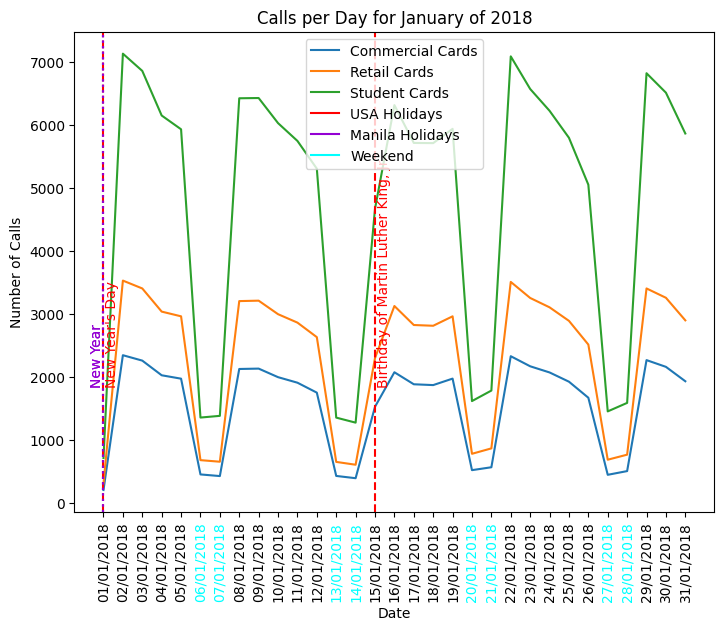

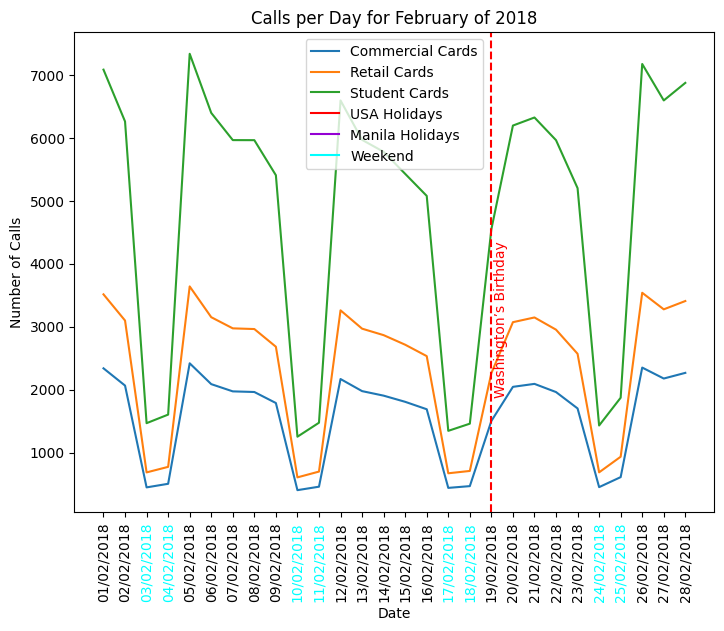

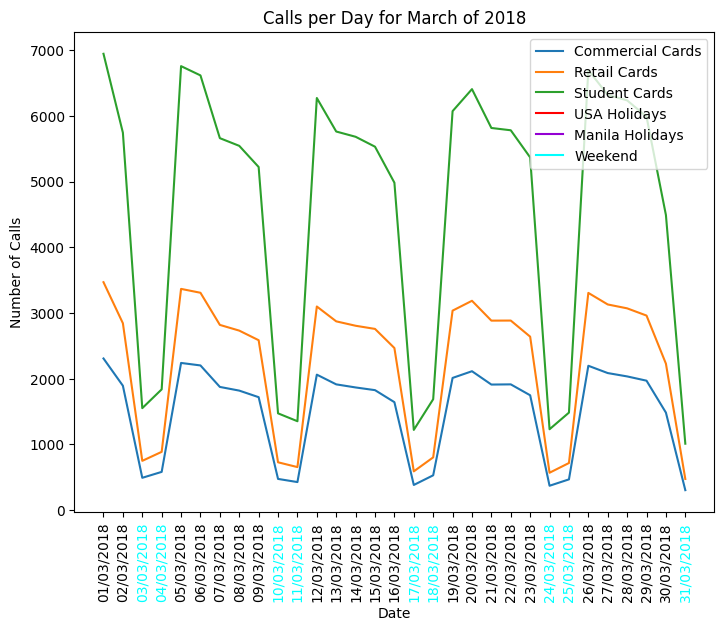

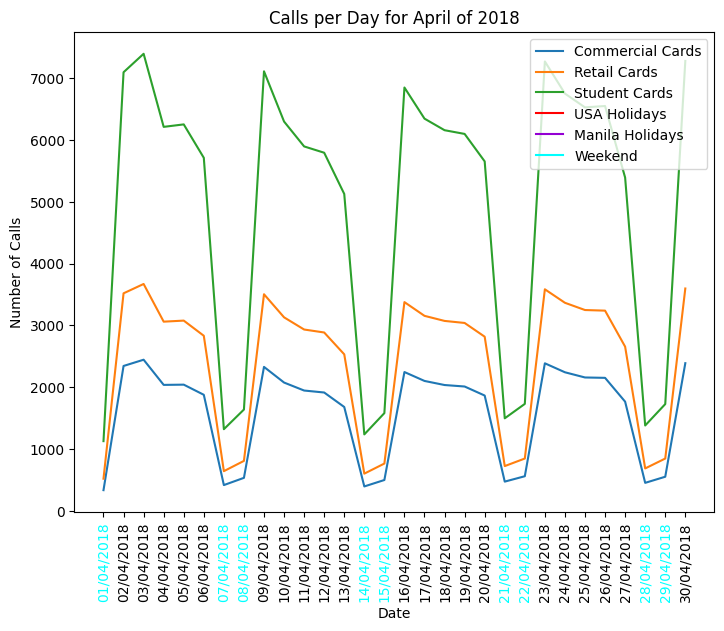

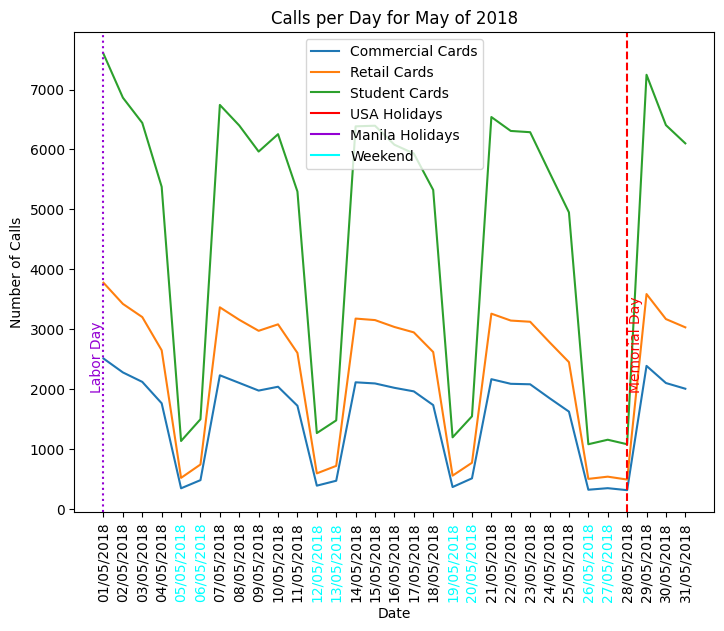

...

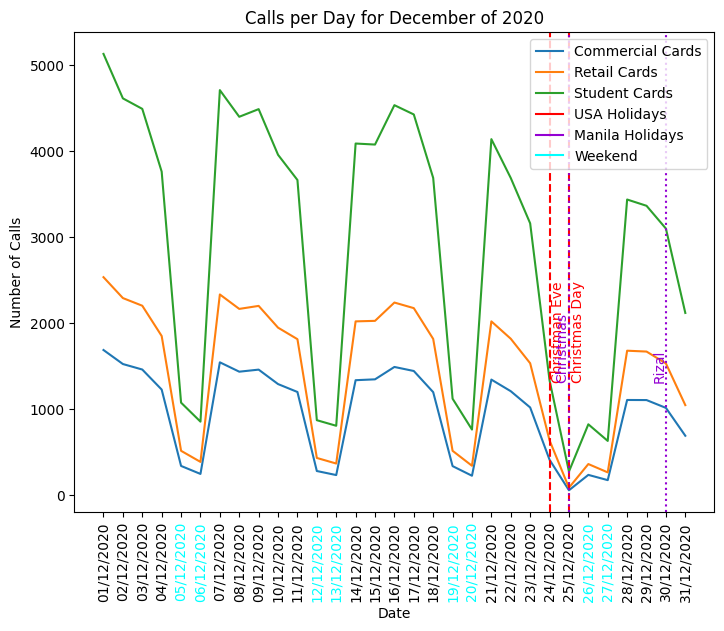

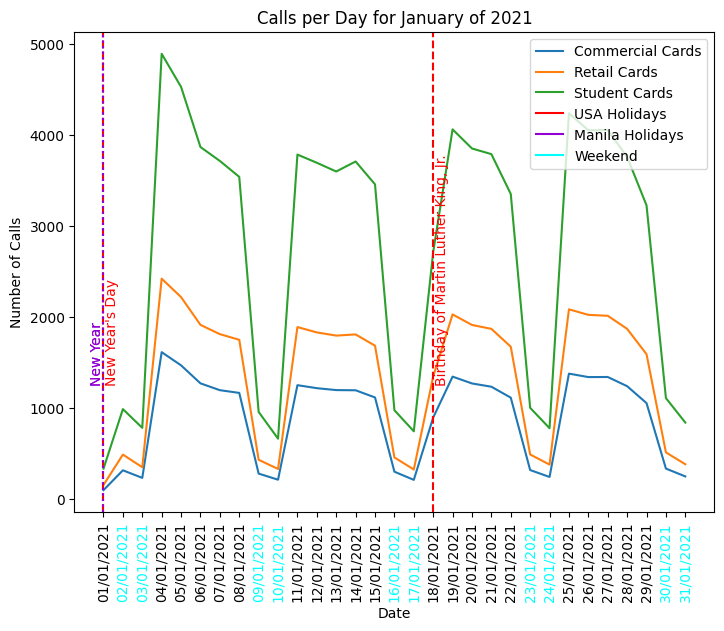

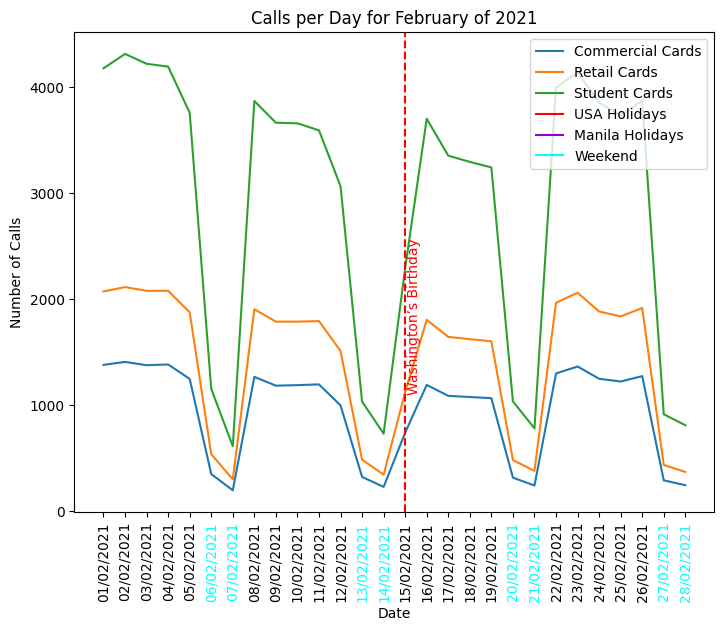

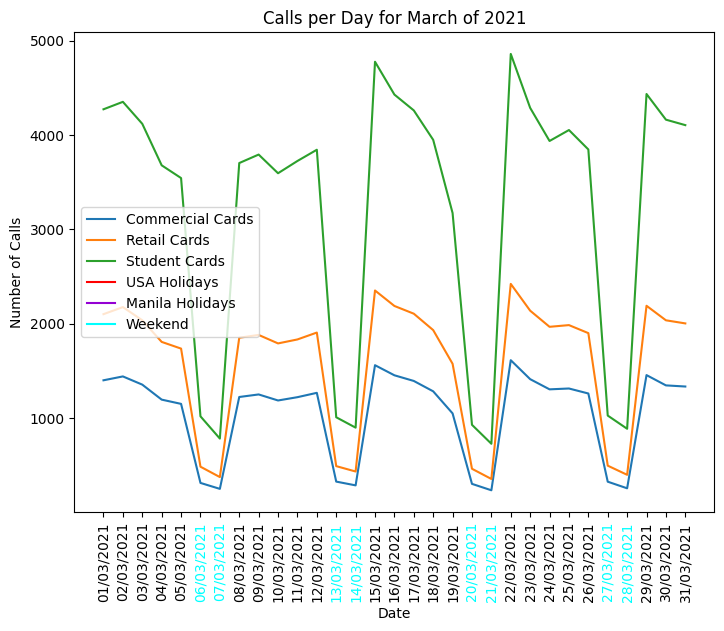

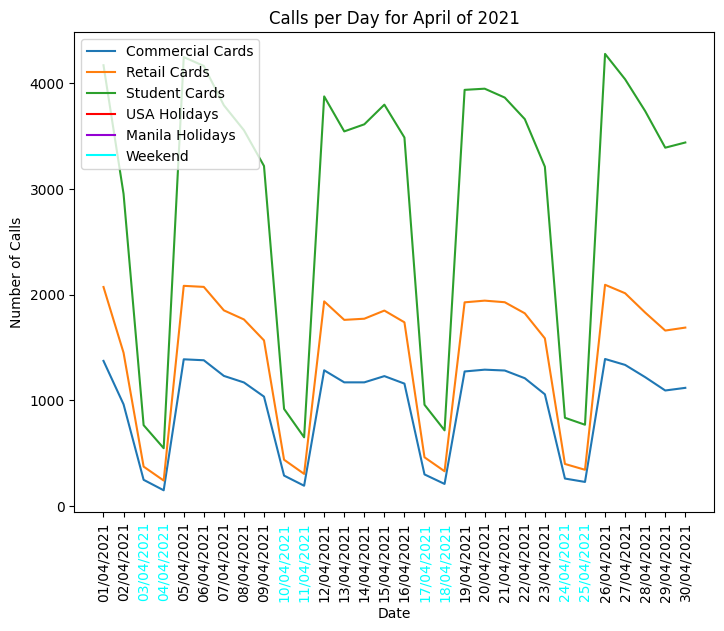

In [ ]:
# 2018-2021 data for each month
# Low number of calls on weekends
# Low number of calls on Big Holidays
years = df_not17_sorted.year.unique()
for y in years:
    holidays_yearly = holidays[[True if dt.year == y else False for dt in holidays.date]]
    m_holidays_yearly = m_holidays[[True if dt.year == y else False for dt in m_holidays.date]]
    df_not17_sorted_yearly = df_not17_sorted[df_not17_sorted.year == y]
    months = df_not17_sorted_yearly.month.unique()
    for m in months:
        x = range((df_not17_sorted_yearly.month == m).sum())
        cc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].cc
        rc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].rc
        sc_values = df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].sc
        month_holidays = holidays_yearly[[True if dt.month == m else False for dt in holidays_yearly.date]]
        monhol_values = [(dt.date.day-1, dt['name']) for i, dt in month_holidays.iterrows()]
        m_month_holidays = m_holidays_yearly[[True if dt.month == m else False for dt in m_holidays_yearly.date]]
        m_monhol_values = [(dt.date.day-1, dt['name']) for i, dt in m_month_holidays.iterrows()]
        fig = plt.figure()
        ax = fig.add_axes([1,1,1,1])
        ax.plot(x, cc_values, label='Commercial Cards')
        ax.plot(x, rc_values, label='Retail Cards')
        ax.plot(x, sc_values, label='Student Cards')
        ax.plot([], [], label='USA Holidays', c='red')
        ax.plot([], [], label='Manila Holidays', c='darkviolet')
        ax.plot([], [], label='Weekend', c='cyan')
        for mhd, mhn in monhol_values:
            if mhn == 'Thanksgiving Day':
                ax.axvline(mhd+1, c='red', ls='--')
                ax.text(mhd+1.1, ax.get_ylim()[1]//4, "Black Friday", rotation=90, c='red')
            if mhn == 'Christmas Day':
                ax.axvline(mhd-1, c='red', ls='--')
                ax.text(mhd-0.9, ax.get_ylim()[1]//4, "Christman Eve", rotation=90, c='red')
            ax.axvline(mhd, c='red', ls='--')
            ax.text(mhd+0.1, ax.get_ylim()[1]//4, mhn, rotation=90, c='red')
            for mhd, mhn in m_monhol_values:
                ax.axvline(mhd, c='darkviolet', ls=':')
                ax.text(mhd-0.7, ax.get_ylim()[1]//4, mhn, rotation=90, c='darkviolet')
        ax.set_xticks(x, df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].date, rotation=90)
        for i, dt in enumerate(df_not17_sorted_yearly[df_not17_sorted_yearly.month == m].date):
            if arrow.get(dt, "DD/MM/YYYY").format("ddd") in ["Sat", "Sun"]:
                ax.get_xticklabels()[i].set_color('cyan')
        ax.set_xlabel("Date")
        ax.set_ylabel("Number of Calls")
        ax.set_title(f"Calls per Day for {arrow.get(str(m), 'M').format('MMMM')} of {y}")
        ax.legend()
        plt.show()

# Prediction

In [ ]:
dates17 = df_17.date.values
dates_not17 = df_not17_sorted.date.values
all_dates = list(dates17)
all_dates.extend(list(dates_not17))
# print(all_dates)
all_dates = pd.to_datetime(all_dates, format="%d/%m/%Y")
# print(all_dates)

In [ ]:
cc17 = df_17.cc.values
cc_not17 = df_not17_sorted.cc.values
all_cc = list(cc17)
all_cc.extend(cc_not17)
# print(all_cc)

In [ ]:
lstm_data = pd.DataFrame({
    "ds": all_dates,
    "y": all_cc
})
lstm_data

,ds,y
0,2017-01-01,264.0
1,2017-01-02,528.0
2,2017-01-03,2505.0
3,2017-01-04,2145.0
4,2017-01-05,2164.0
...,...,...
1576,2021-04-26,1392.0
1577,2021-04-27,1336.0
1578,2021-04-28,1220.0
1579,2021-04-29,1094.0


In [ ]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten

In [ ]:
# preparing independent and dependent features
def prepare_data(timeseries_data, n_features):
	X, y =[],[]
	for i in range(len(timeseries_data)):
		# find the end of this pattern
		end_ix = i + n_features
		# check if we are beyond the sequence
		if end_ix > len(timeseries_data)-1:
			break
		# gather input and output parts of the pattern
		seq_x, seq_y = timeseries_data[i:end_ix], timeseries_data[end_ix]
		X.append(seq_x)
		y.append(seq_y)
	return np.array(X), np.array(y)

In [ ]:
# define input sequence
timeseries_data = all_cc
# choose a number of time steps
n_steps = 7
# split into samples
X, y = prepare_data(timeseries_data, n_steps)

In [ ]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X = X.reshape((X.shape[0], X.shape[1], n_features))

In [ ]:
# define model
model = Sequential()
model.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model.add(LSTM(50, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
# fit model
model.fit(X, y, epochs=500, verbose=1)

Epoch 1/500
50/50 [==============================] - 2s 3ms/step - loss: 1113896.0000
Epoch 2/500
50/50 [==============================] - 0s 3ms/step - loss: 195022.7969
Epoch 3/500
50/50 [==============================] - 0s 3ms/step - loss: 136563.2969
Epoch 4/500
50/50 [==============================] - 0s 3ms/step - loss: 118197.0859
Epoch 5/500
50/50 [==============================] - 0s 3ms/step - loss: 104599.4922
Epoch 6/500
50/50 [==============================] - 0s 3ms/step - loss: 177772.3594
Epoch 7/500
50/50 [==============================] - 0s 3ms/step - loss: 181992.1094
Epoch 8/500
50/50 [==============================] - 0s 3ms/step - loss: 208646.7500
Epoch 9/500
50/50 [==============================] - 0s 3ms/step - loss: 236557.4375
Epoch 10/500
50/50 [==============================] - 0s 3ms/step - loss: 154889.8125
Epoch 11/500
50/50 [==============================] - 0s 3ms/step - loss: 138113.7344
Epoch 12/500
50/50 [==============================] - 0s 3ms/s

50/50 [==============================] - 0s 3ms/step - loss: 87790.7734
Epoch 98/500
50/50 [==============================] - 0s 3ms/step - loss: 95836.8359
Epoch 99/500
50/50 [==============================] - 0s 3ms/step - loss: 92070.5703
Epoch 100/500
50/50 [==============================] - 0s 3ms/step - loss: 88539.7578
Epoch 101/500
50/50 [==============================] - 0s 3ms/step - loss: 86123.0391
Epoch 102/500
50/50 [==============================] - 0s 3ms/step - loss: 86980.2422
Epoch 103/500
50/50 [==============================] - 0s 3ms/step - loss: 86380.9062
Epoch 104/500
50/50 [==============================] - 0s 3ms/step - loss: 85733.5625
Epoch 105/500
50/50 [==============================] - 0s 3ms/step - loss: 82195.7344
Epoch 106/500
50/50 [==============================] - 0s 3ms/step - loss: 82278.3047
Epoch 107/500
50/50 [==============================] - 0s 3ms/step - loss: 81558.0469
Epoch 108/500
50/50 [==============================] - 0s 3ms/step - l

50/50 [==============================] - 0s 3ms/step - loss: 62531.1094
Epoch 193/500
50/50 [==============================] - 0s 3ms/step - loss: 62554.2891
Epoch 194/500
50/50 [==============================] - 0s 3ms/step - loss: 60903.7461
Epoch 195/500
50/50 [==============================] - 0s 3ms/step - loss: 62881.3516
Epoch 196/500
50/50 [==============================] - 0s 3ms/step - loss: 60029.3047
Epoch 197/500
50/50 [==============================] - 0s 3ms/step - loss: 64028.3945
Epoch 198/500
50/50 [==============================] - 0s 3ms/step - loss: 90664.1797
Epoch 199/500
50/50 [==============================] - 0s 3ms/step - loss: 87862.4375
Epoch 200/500
50/50 [==============================] - 0s 3ms/step - loss: 68848.2812
Epoch 201/500
50/50 [==============================] - 0s 3ms/step - loss: 70229.1953
Epoch 202/500
50/50 [==============================] - 0s 3ms/step - loss: 68492.6641
Epoch 203/500
50/50 [==============================] - 0s 3ms/step -

50/50 [==============================] - 0s 3ms/step - loss: 56731.3594
Epoch 288/500
50/50 [==============================] - 0s 3ms/step - loss: 53536.9141
Epoch 289/500
50/50 [==============================] - 0s 3ms/step - loss: 52861.0742
Epoch 290/500
50/50 [==============================] - 0s 3ms/step - loss: 51429.3438
Epoch 291/500
50/50 [==============================] - 0s 3ms/step - loss: 51069.2266
Epoch 292/500
50/50 [==============================] - 0s 3ms/step - loss: 51850.6445
Epoch 293/500
50/50 [==============================] - 0s 3ms/step - loss: 50548.7656
Epoch 294/500
50/50 [==============================] - 0s 3ms/step - loss: 55165.5820
Epoch 295/500
50/50 [==============================] - 0s 3ms/step - loss: 52035.3594
Epoch 296/500
50/50 [==============================] - 0s 3ms/step - loss: 49966.8242
Epoch 297/500
50/50 [==============================] - 0s 3ms/step - loss: 50684.6445
Epoch 298/500
50/50 [==============================] - 0s 3ms/step -

50/50 [==============================] - 0s 3ms/step - loss: 46370.6719
Epoch 383/500
50/50 [==============================] - 0s 3ms/step - loss: 44439.8320
Epoch 384/500
50/50 [==============================] - 0s 3ms/step - loss: 46508.0156
Epoch 385/500
50/50 [==============================] - 0s 3ms/step - loss: 45388.8672
Epoch 386/500
50/50 [==============================] - 0s 3ms/step - loss: 42608.9219
Epoch 387/500
50/50 [==============================] - 0s 3ms/step - loss: 43947.3477
Epoch 388/500
50/50 [==============================] - 0s 3ms/step - loss: 45329.0938
Epoch 389/500
50/50 [==============================] - 0s 3ms/step - loss: 44419.5391
Epoch 390/500
50/50 [==============================] - 0s 3ms/step - loss: 44943.0273
Epoch 391/500
50/50 [==============================] - 0s 3ms/step - loss: 46733.3477
Epoch 392/500
50/50 [==============================] - 0s 3ms/step - loss: 44704.1992
Epoch 393/500
50/50 [==============================] - 0s 3ms/step -

50/50 [==============================] - 0s 3ms/step - loss: 47392.9219
Epoch 478/500
50/50 [==============================] - 0s 3ms/step - loss: 48523.0234
Epoch 479/500
50/50 [==============================] - 0s 3ms/step - loss: 47171.2109
Epoch 480/500
50/50 [==============================] - 0s 3ms/step - loss: 46567.7070
Epoch 481/500
50/50 [==============================] - 0s 3ms/step - loss: 49875.6289
Epoch 482/500
50/50 [==============================] - 0s 3ms/step - loss: 48415.7109
Epoch 483/500
50/50 [==============================] - 0s 3ms/step - loss: 47719.2031
Epoch 484/500
50/50 [==============================] - 0s 3ms/step - loss: 46446.1719
Epoch 485/500
50/50 [==============================] - 0s 3ms/step - loss: 48748.6797
Epoch 486/500
50/50 [==============================] - 0s 3ms/step - loss: 53519.6836
Epoch 487/500
50/50 [==============================] - 0s 3ms/step - loss: 49007.4453
Epoch 488/500
50/50 [==============================] - 0s 3ms/step -

In [ ]:
from numpy import array
# demonstrate prediction for next 10 days
x_input = array(all_cc[-7:])
temp_input=list(x_input)
lst_output=[]
i=0
while(i<7):
    
    if(len(temp_input)>7):
        x_input=array(temp_input[1:])
#         print("{} day input {}".format(i,x_input))
        #print(x_input)
        x_input = x_input.reshape((1, n_steps, n_features))
        #print(x_input)
        yhat = model.predict(x_input, verbose=0)
#         print("{} day output {}".format(i,yhat))
        temp_input.append(yhat[0][0])
        temp_input=temp_input[1:]
        #print(temp_input)
        lst_output.append(yhat[0][0])
        i=i+1
    else:
        x_input = x_input.reshape((1, n_steps, n_features))
        yhat = model.predict(x_input, verbose=0)
#         print(yhat[0])
        temp_input.append(yhat[0][0])
        lst_output.append(yhat[0][0])
        i=i+1
    

print(lst_output)

[377.71722, 255.75018, 1335.5135, 1292.8608, 1224.441, 1194.5858, 1094.1954]


In [ ]:
pred_data = lstm_data.loc[ [(dt.month==4) & (dt.year==2021) for dt in lstm_data.ds] ]
pred_data.reset_index(drop=True, inplace=True)
pred_data

,ds,y
0,2021-04-01,1374.0
1,2021-04-02,963.0
2,2021-04-03,249.0
3,2021-04-04,150.0
4,2021-04-05,1389.0
5,2021-04-06,1380.0
6,2021-04-07,1232.0
7,2021-04-08,1170.0
8,2021-04-09,1036.0
9,2021-04-10,289.0


In [ ]:
tmp = pd.concat((pred_data, pd.DataFrame({
    "ds": pd.date_range(start='5/1/2021', periods=7).strftime('%Y-%m-%d'),
    "y": lst_output
})))
# pd.DataFrame({
#     "ds": pd.date_range(start='5/1/2021', periods=10).strftime('%Y-%m-%d'),
#     "y": lst_output
# })

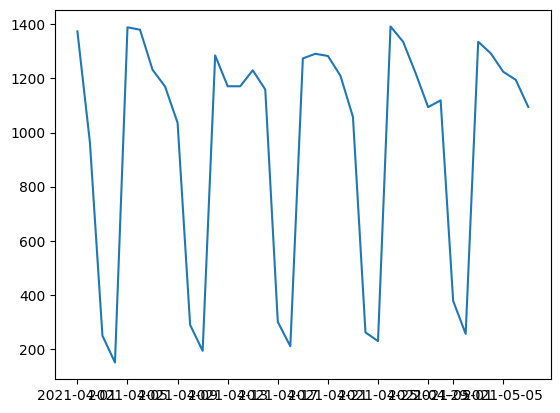

In [ ]:
plt.plot(tmp.ds, tmp.y)

In [ ]:
tmp[-7:]

,ds,y
0,2021-05-01,377.717224
1,2021-05-02,255.750183
2,2021-05-03,1335.513550
3,2021-05-04,1292.860840
4,2021-05-05,1224.441040
5,2021-05-06,1194.585815
6,2021-05-07,1094.195435


In [ ]:
pd.DataFrame({
    "Date": pd.date_range(start='5/1/2021', periods=7).strftime('%m/%d/%Y'),
    "No_calls_Offered_predicted": tmp[-7:].y.to_list()
}).to_csv("week_prediction.csv", index=False)

In [ ]:
df_17_cumm = df_17[['cc', 'rc' , 'sc', 'month']].groupby('month').sum()

In [ ]:
years = df_not17_sorted.year.unique()
for y in years:
    df_not17_sorted_yearly = df_not17_sorted[df_not17_sorted.year == y]
    df_cumm = df_not17_sorted_yearly[['cc', 'rc' , 'sc', 'month']].groupby('month').sum()
#     print(df_cumm)
    df_17_cumm = pd.concat((df_17_cumm, df_cumm))

In [ ]:
df_17_cumm

,cc,rc,sc
month,,,
1,48239.0,72702.0,147207.0
2,42176.0,63558.0,128753.0
3,46218.0,69673.0,140998.0
4,42362.0,63850.0,128841.0
5,45914.0,69202.0,140060.0
6,45519.0,68574.0,138623.0
7,41117.0,61970.0,125464.0
8,42484.0,63969.0,129310.0
9,39754.0,59901.0,121404.0


In [ ]:
lstm_data = pd.DataFrame({
    "ds": df_17_cumm.index,
    "y": df_17_cumm.cc
})
lstm_data

,ds,y
month,,
1,1,48239.0
2,2,42176.0
3,3,46218.0
4,4,42362.0
5,5,45914.0
6,6,45519.0
7,7,41117.0
8,8,42484.0
9,9,39754.0


In [ ]:
# define input sequence
timeseries_data = df_17_cumm.cc.to_list()
# choose a number of time steps
n_steps = 12
# split into samples
X, y = prepare_data(timeseries_data, n_steps)

In [ ]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X = X.reshape((X.shape[0], X.shape[1], n_features))

In [ ]:
# define model
model = Sequential()
model.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model.add(LSTM(50, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
# fit model
model.fit(X, y, epochs=500, verbose=1)

Epoch 1/500
2/2 [==============================] - 2s 6ms/step - loss: 1711399168.0000
Epoch 2/500
2/2 [==============================] - 0s 5ms/step - loss: 1733785216.0000
Epoch 3/500
2/2 [==============================] - 0s 5ms/step - loss: 1751710976.0000
Epoch 4/500
2/2 [==============================] - 0s 4ms/step - loss: 1630898816.0000
Epoch 5/500
2/2 [==============================] - 0s 7ms/step - loss: 1698453888.0000
Epoch 6/500
2/2 [==============================] - 0s 7ms/step - loss: 1739772544.0000
Epoch 7/500
2/2 [==============================] - 0s 5ms/step - loss: 1713522688.0000
Epoch 8/500
2/2 [==============================] - 0s 5ms/step - loss: 1706387840.0000
Epoch 9/500
2/2 [==============================] - 0s 7ms/step - loss: 1659777280.0000
Epoch 10/500
2/2 [==============================] - 0s 7ms/step - loss: 1615126144.0000
Epoch 11/500
2/2 [==============================] - 0s 5ms/step - loss: 1606615296.0000
Epoch 12/500
2/2 [=======================

2/2 [==============================] - 0s 6ms/step - loss: 54145240.0000
Epoch 96/500
2/2 [==============================] - 0s 5ms/step - loss: 54033600.0000
Epoch 97/500
2/2 [==============================] - 0s 5ms/step - loss: 51446060.0000
Epoch 98/500
2/2 [==============================] - 0s 6ms/step - loss: 50044096.0000
Epoch 99/500
2/2 [==============================] - 0s 7ms/step - loss: 50847176.0000
Epoch 100/500
2/2 [==============================] - 0s 7ms/step - loss: 50968440.0000
Epoch 101/500
2/2 [==============================] - 0s 6ms/step - loss: 50552676.0000
Epoch 102/500
2/2 [==============================] - 0s 5ms/step - loss: 78714296.0000
Epoch 103/500
2/2 [==============================] - 0s 6ms/step - loss: 63657504.0000
Epoch 104/500
2/2 [==============================] - 0s 7ms/step - loss: 40070064.0000
Epoch 105/500
2/2 [==============================] - 0s 5ms/step - loss: 36426584.0000
Epoch 106/500
2/2 [==============================] - 0s 5ms/s

2/2 [==============================] - 0s 7ms/step - loss: 47277444.0000
Epoch 190/500
2/2 [==============================] - 0s 5ms/step - loss: 37843008.0000
Epoch 191/500
2/2 [==============================] - 0s 5ms/step - loss: 39021112.0000
Epoch 192/500
2/2 [==============================] - 0s 7ms/step - loss: 37581944.0000
Epoch 193/500
2/2 [==============================] - 0s 6ms/step - loss: 32806118.0000
Epoch 194/500
2/2 [==============================] - 0s 5ms/step - loss: 33484246.0000
Epoch 195/500
2/2 [==============================] - 0s 6ms/step - loss: 25744468.0000
Epoch 196/500
2/2 [==============================] - 0s 6ms/step - loss: 25867676.0000
Epoch 197/500
2/2 [==============================] - 0s 7ms/step - loss: 29323244.0000
Epoch 198/500
2/2 [==============================] - 0s 5ms/step - loss: 31888918.0000
Epoch 199/500
2/2 [==============================] - 0s 6ms/step - loss: 29079402.0000
Epoch 200/500
2/2 [==============================] - 0s 7

2/2 [==============================] - 0s 6ms/step - loss: 35015628.0000
Epoch 284/500
2/2 [==============================] - 0s 5ms/step - loss: 34945284.0000
Epoch 285/500
2/2 [==============================] - 0s 5ms/step - loss: 35351360.0000
Epoch 286/500
2/2 [==============================] - 0s 7ms/step - loss: 35358164.0000
Epoch 287/500
2/2 [==============================] - 0s 4ms/step - loss: 34867624.0000
Epoch 288/500
2/2 [==============================] - 0s 5ms/step - loss: 35386568.0000
Epoch 289/500
2/2 [==============================] - 0s 5ms/step - loss: 35709736.0000
Epoch 290/500
2/2 [==============================] - 0s 6ms/step - loss: 35737032.0000
Epoch 291/500
2/2 [==============================] - 0s 5ms/step - loss: 34921608.0000
Epoch 292/500
2/2 [==============================] - 0s 5ms/step - loss: 34773888.0000
Epoch 293/500
2/2 [==============================] - 0s 6ms/step - loss: 34656984.0000
Epoch 294/500
2/2 [==============================] - 0s 5

2/2 [==============================] - 0s 7ms/step - loss: 34633456.0000
Epoch 378/500
2/2 [==============================] - 0s 5ms/step - loss: 33954496.0000
Epoch 379/500
2/2 [==============================] - 0s 4ms/step - loss: 33368314.0000
Epoch 380/500
2/2 [==============================] - 0s 5ms/step - loss: 32876852.0000
Epoch 381/500
2/2 [==============================] - 0s 6ms/step - loss: 33042524.0000
Epoch 382/500
2/2 [==============================] - 0s 5ms/step - loss: 33512244.0000
Epoch 383/500
2/2 [==============================] - 0s 5ms/step - loss: 33662200.0000
Epoch 384/500
2/2 [==============================] - 0s 6ms/step - loss: 33235028.0000
Epoch 385/500
2/2 [==============================] - 0s 7ms/step - loss: 32688592.0000
Epoch 386/500
2/2 [==============================] - 0s 6ms/step - loss: 32430564.0000
Epoch 387/500
2/2 [==============================] - 0s 5ms/step - loss: 32645952.0000
Epoch 388/500
2/2 [==============================] - 0s 6

2/2 [==============================] - 0s 5ms/step - loss: 28986698.0000
Epoch 472/500
2/2 [==============================] - 0s 6ms/step - loss: 28658938.0000
Epoch 473/500
2/2 [==============================] - 0s 6ms/step - loss: 28758948.0000
Epoch 474/500
2/2 [==============================] - 0s 4ms/step - loss: 29706368.0000
Epoch 475/500
2/2 [==============================] - 0s 6ms/step - loss: 29657092.0000
Epoch 476/500
2/2 [==============================] - 0s 5ms/step - loss: 28371226.0000
Epoch 477/500
2/2 [==============================] - 0s 5ms/step - loss: 29128202.0000
Epoch 478/500
2/2 [==============================] - 0s 4ms/step - loss: 29468544.0000
Epoch 479/500
2/2 [==============================] - 0s 7ms/step - loss: 28635014.0000
Epoch 480/500
2/2 [==============================] - 0s 5ms/step - loss: 28024636.0000
Epoch 481/500
2/2 [==============================] - 0s 5ms/step - loss: 28779030.0000
Epoch 482/500
2/2 [==============================] - 0s 6

In [ ]:
from numpy import array
# demonstrate prediction for next 10 days
x_input = array(df_17_cumm.cc.to_list()[-12:])
temp_input=list(x_input)
lst_output=[]
i=0
while(i<3):
    
    if(len(temp_input)>12):
        x_input=array(temp_input[1:])
#         print("{} day input {}".format(i,x_input))
        #print(x_input)
        x_input = x_input.reshape((1, n_steps, n_features))
        #print(x_input)
        yhat = model.predict(x_input, verbose=0)
#         print("{} day output {}".format(i,yhat))
        temp_input.append(yhat[0][0])
        temp_input=temp_input[1:]
        #print(temp_input)
        lst_output.append(yhat[0][0])
        i=i+1
    else:
        x_input = x_input.reshape((1, n_steps, n_features))
        yhat = model.predict(x_input, verbose=0)
#         print(yhat[0])
        temp_input.append(yhat[0][0])
        lst_output.append(yhat[0][0])
        i=i+1
    

print(lst_output)

[27170.455, 27841.54, 27784.979]


In [ ]:
pred_data = lstm_data[-16:]
pred_data.reset_index(drop=True, inplace=True)
pred_data

,ds,y
0,1,44327.0
1,2,40076.0
2,3,38164.0
3,4,32852.0
4,5,27944.0
5,6,30685.0
6,7,30571.0
7,8,31314.0
8,9,30954.0
9,10,34179.0


In [ ]:
tmp = pd.concat((pred_data, pd.DataFrame({
    "ds": [5, 6, 7],
    "y": lst_output
})))

In [ ]:
tmp.reset_index(drop=True, inplace=True)

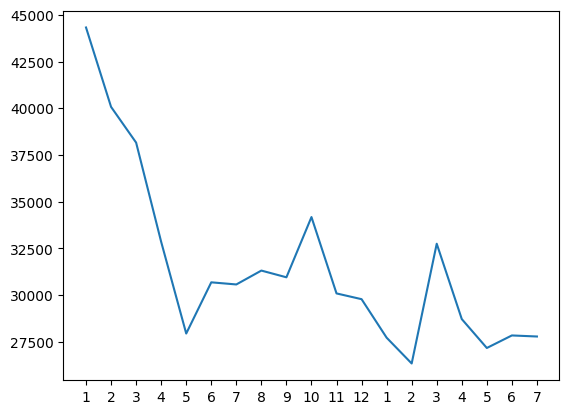

In [ ]:
ax = plt.axes()
plt.plot(tmp.index, tmp.y)
ax.set_xticks(tmp.index, tmp.ds)

In [ ]:
tmp[-3:]

,ds,y
16,5,27170.455078
17,6,27841.539062
18,7,27784.978516


In [ ]:
pd.DataFrame({
    "Month":["01/05/2021", "01/06/2021", "01/07/2021"],
    "No_calls_Offered_predicted": tmp[-3:].y.to_list()
}).to_csv("month_pred.csv", index=False)

In [ ]:
lstm_data

,ds,y
month,,
1,1,48239.0
2,2,42176.0
3,3,46218.0
4,4,42362.0
5,5,45914.0
6,6,45519.0
7,7,41117.0
8,8,42484.0
9,9,39754.0


In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler=MinMaxScaler(feature_range=(0,1))

In [ ]:
all_data = lstm_data.values

In [ ]:
all_data.shape

(1581, 2)

In [ ]:
train_data = all_data[0:1000,:]
test_data = all_data[1000:1000+400,:]
val_data = all_data[1000+400:,:]

In [ ]:
lstm_data.index = lstm_data.ds
lstm_data.drop('ds', axis = 1, inplace = True)

In [ ]:
scaled_data = scaler.fit_transform(lstm_data)

In [ ]:
x_train_data,y_train_data=[],[]

for i in range(30,len(train_data)):
    x_train_data.append(scaled_data[i-30:i,0])
    y_train_data.append(scaled_data[i,0])

In [ ]:
x_train_data,y_train_data=np.array(x_train_data),np.array(y_train_data)
x_train_data=np.reshape(x_train_data,(x_train_data.shape[0],x_train_data.shape[1],1))

In [ ]:
from keras.models import Sequential
from sklearn.pipeline import Pipeline
from keras.layers import LSTM, Dropout, Dense

In [ ]:
lstm_model=Sequential()
lstm_model.add(LSTM(units=50,return_sequences=True,input_shape=(x_train_data.shape[1],1)))
lstm_model.add(LSTM(units=50))
lstm_model.add(Dense(1))

inputs_data=lstm_data[len(lstm_data)-len(val_data)-400:1000+400].values
inputs_data=inputs_data.reshape(-1,1)
inputs_data=scaler.transform(inputs_data)

lstm_model.compile(loss='mean_squared_error',optimizer='adam')
lstm_model.fit(x_train_data,y_train_data,epochs=1,batch_size=1,verbose=1)

C:\Users\DV\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(


970/970 [==============================] - 8s 6ms/step - loss: 0.0538


In [ ]:
X_test=[]
for i in range(30,inputs_data.shape[0]):
    X_test.append(inputs_data[i-30:i,0])
X_test=np.array(X_test)

X_test=np.reshape(X_test,(X_test.shape[0],X_test.shape[1],1))
predicted_closing_price=lstm_model.predict(X_test)
predicted_closing_price=scaler.inverse_transform(predicted_closing_price)

12/12 [==============================] - 0s 3ms/step


In [ ]:
trd = lstm_data[0:1000]
tsd = lstm_data[1000+30:1000+400]

In [ ]:
tsd['Pred'] = predicted_closing_price

C:\Users\DV\AppData\Local\Temp\ipykernel_19112\3216645329.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tsd['Pred'] = predicted_closing_price


In [ ]:
tsd

,y,Pred
ds,,
2019-10-28,2053.0,1842.804199
2019-10-29,1935.0,2334.072021
2019-10-30,2060.0,2418.739746
2019-10-31,1778.0,2099.878418
2019-11-01,1809.0,1616.503540
...,...,...
2020-10-27,1605.0,2013.805908
2020-10-28,1614.0,2037.563477
2020-10-29,1522.0,1800.224731


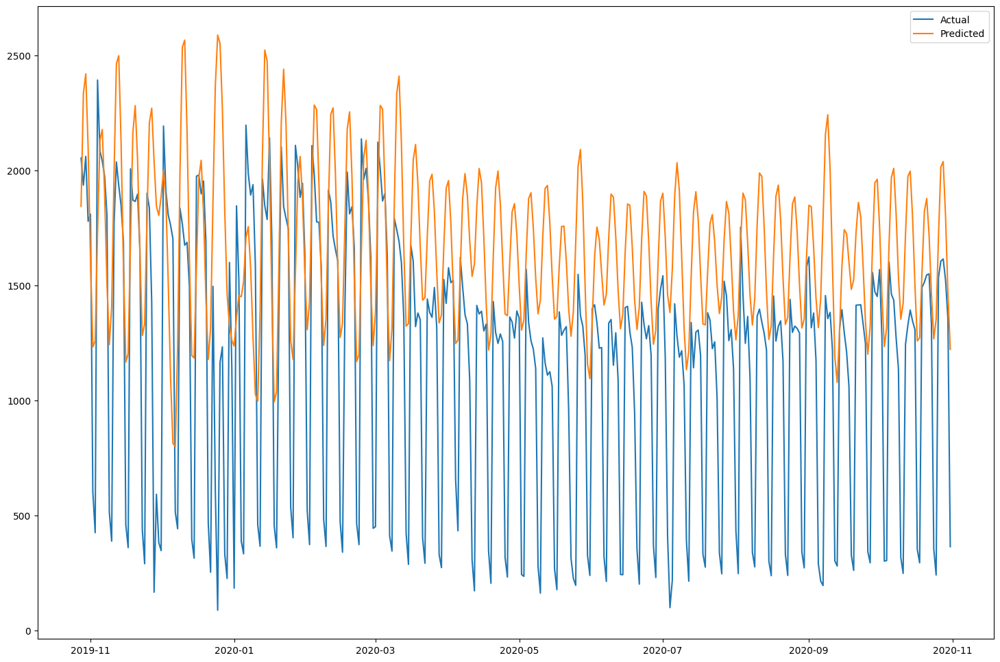

In [ ]:
fig, ax = plt.subplots(figsize=(18,12))
plt.plot(tsd.y, label='Actual')
plt.plot(tsd["Pred"], label='Predicted')
plt.legend()
plt.show()

In [ ]:
predicted_closing_price.shape

(370, 1)

In [ ]:
lstm_data[len(lstm_data)-len(val_data)-30:1000+400].values

array([[1269.],
       [ 300.],
       [ 303.],
       [1601.],
       [1461.],
       [1435.],
       [1273.],
       [1136.],
       [ 316.],
       [ 247.],
       [1243.],
       [1326.],
       [1392.],
       [1344.],
       [1307.],
       [ 351.],
       [ 293.],
       [1490.],
       [1513.],
       [1545.],
       [1549.],
       [1331.],
       [ 353.],
       [ 240.],
       [1534.],
       [1605.],
       [1614.],
       [1522.],
       [1355.],
       [ 363.]])

In [ ]:
tsd

,y
ds,
2019-10-28,2053.0
2019-10-29,1935.0
2019-10-30,2060.0
2019-10-31,1778.0
2019-11-01,1809.0
...,...
2020-10-27,1605.0
2020-10-28,1614.0
2020-10-29,1522.0


In [ ]:
predicted_closing_price

array([[1842.8042],
       [2334.072 ],
       [2418.7397],
       [2099.8784],
       [1616.5035],
       [1232.0956],
       [1257.5872],
       [1728.2781],
       [2129.961 ],
       [2176.6262],
       [1903.156 ],
       [1509.7295],
       [1241.9193],
       [1404.8439],
       [1979.5037],
       [2462.3196],
       [2497.6514],
       [2118.308 ],
       [1579.0979],
       [1166.1064],
       [1201.8636],
       [1698.9268],
       [2163.4016],
       [2280.781 ],
       [2044.0519],
       [1625.6841],
       [1281.4686],
       [1330.3325],
       [1794.6653],
       [2206.1448],
       [2269.3901],
       [2040.8314],
       [1843.9038],
       [1803.429 ],
       [1885.5533],
       [1998.3645],
       [1878.9131],
       [1517.6407],
       [1097.49  ],
       [ 812.5472],
       [ 798.4467],
       [1231.3523],
       [1988.3202],
       [2534.499 ],
       [2565.591 ],
       [2168.307 ],
       [1618.0852],
       [1194.744 ],
       [1183.6005],
       [1588.7065],


In [ ]:
lstm_data[1000+400:].shape

(181, 1)

(0,)

In [ ]:
US_holidays_series = cal.holidays(start='2017-01-01', end='2021-07-31', return_name=True)
US_holidays = US_holidays_series.to_frame("name")
US_holidays.reset_index(inplace=True)
US_holidays.rename(columns={"index":"date"}, inplace=True)

In [ ]:
prophet_holiday_df = pd.DataFrame(columns=["holiday", "ds", "lower_window", "upper_window"])
all_US_holidays = US_holidays.name.unique()
for h in all_US_holidays:
    print(h)
    if h == "Thanksgiving Day":
        df_hday = pd.DataFrame({
            'holiday': h,
            'ds': pd.to_datetime(US_holidays[US_holidays.name == h].date),
            'lower_window': 0,
            'upper_window': 1
        })
    elif h == "Christmas Day":
        df_hday = pd.DataFrame({
            'holiday': h,
            'ds': pd.to_datetime(US_holidays[US_holidays.name == h].date),
            'lower_window': -1,
            'upper_window': 0
        })
    else:
        df_hday = pd.DataFrame({
            'holiday': h,
            'ds': pd.to_datetime(US_holidays[US_holidays.name == h].date),
            'lower_window': 0,
            'upper_window': 0
        })
    df_hday.reset_index(drop=True, inplace=True)
    prophet_holiday_df = pd.concat((prophet_holiday_df, df_hday))

New Year's Day
Birthday of Martin Luther King, Jr.
Washington’s Birthday
Memorial Day
Independence Day
Labor Day
Columbus Day
Veterans Day
Thanksgiving Day
Christmas Day
Juneteenth National Independence Day


In [ ]:
prophet_holiday_df

,holiday,ds,lower_window,upper_window
0,New Year's Day,2017-01-02,0,0
1,New Year's Day,2018-01-01,0,0
2,New Year's Day,2019-01-01,0,0
3,New Year's Day,2020-01-01,0,0
4,New Year's Day,2021-01-01,0,0
0,"Birthday of Martin Luther King, Jr.",2017-01-16,0,0
1,"Birthday of Martin Luther King, Jr.",2018-01-15,0,0
2,"Birthday of Martin Luther King, Jr.",2019-01-21,0,0
3,"Birthday of Martin Luther King, Jr.",2020-01-20,0,0
4,"Birthday of Martin Luther King, Jr.",2021-01-18,0,0


In [ ]:
all_Manila_holidays = manila_cal.holidays(start="2017-01-01",end="2021-07-31",return_name=True)
all_m_holidays = all_Manila_holidays.to_frame("name")
all_m_holidays.reset_index(inplace=True)
all_m_holidays.rename(columns={"index":"date"}, inplace=True)

In [ ]:
all_Man_holidays = all_m_holidays.name.unique()
for h in all_Man_holidays:
    print(h)
    df_hday = pd.DataFrame({
        'holiday': "Manila " + str(h),
        'ds': pd.to_datetime(holidays[holidays.name == h].date),
        'lower_window': 0,
        'upper_window': 0
    })
    df_hday.reset_index(drop=True, inplace=True)
    prophet_holiday_df = pd.concat((prophet_holiday_df, df_hday))

New Year
Day of Valor
Maundy Thursday
Good Friday
Labor Day
Independence Day
National heroes day
Bonifacio
Christmas
Rizal


In [ ]:
prophet_holiday_df

,holiday,ds,lower_window,upper_window
0,New Year's Day,2017-01-02,0,0
1,New Year's Day,2018-01-01,0,0
2,New Year's Day,2019-01-01,0,0
3,New Year's Day,2020-01-01,0,0
4,New Year's Day,2021-01-01,0,0
0,"Birthday of Martin Luther King, Jr.",2017-01-16,0,0
1,"Birthday of Martin Luther King, Jr.",2018-01-15,0,0
2,"Birthday of Martin Luther King, Jr.",2019-01-21,0,0
3,"Birthday of Martin Luther King, Jr.",2020-01-20,0,0
4,"Birthday of Martin Luther King, Jr.",2021-01-18,0,0


In [ ]:
dates17 = df_17.date.values
dates_not17 = df_not17_sorted.date.values
all_dates = list(dates17)
all_dates.extend(list(dates_not17))
# print(all_dates)
all_dates = pd.to_datetime(all_dates, format="%d/%m/%Y")
# print(all_dates)

In [ ]:
cc17 = df_17.cc.values
cc_not17 = df_not17_sorted.cc.values
all_cc = list(cc17)
all_cc.extend(cc_not17)
# print(all_cc)

In [ ]:
fbp_data = pd.DataFrame({
    "ds": all_dates,
    "y": all_cc
})
fbp_data

,ds,y
0,2017-01-01,264.0
1,2017-01-02,528.0
2,2017-01-03,2505.0
3,2017-01-04,2145.0
4,2017-01-05,2164.0
...,...,...
1576,2021-04-26,1392.0
1577,2021-04-27,1336.0
1578,2021-04-28,1220.0
1579,2021-04-29,1094.0


In [ ]:
fbp_model = Prophet(holidays=prophet_holiday_df)

In [ ]:
fbp_model_fit = fbp_model.fit(fbp_data)

03:00:39 - cmdstanpy - INFO - Chain [1] start processing
03:00:39 - cmdstanpy - INFO - Chain [1] done processing


In [ ]:
future = fbp_model_fit.make_future_dataframe(periods=92)

In [ ]:
forecast = fbp_model_fit.predict(future)

In [ ]:
forecast[['ds', 'yhat']]

,ds,yhat
0,2017-01-01,390.268378
1,2017-01-02,510.781987
2,2017-01-03,1919.418719
3,2017-01-04,1844.600461
4,2017-01-05,1818.181766
...,...,...
1668,2021-07-27,1382.759824
1669,2021-07-28,1289.212060
1670,2021-07-29,1242.581627
1671,2021-07-30,1081.108678


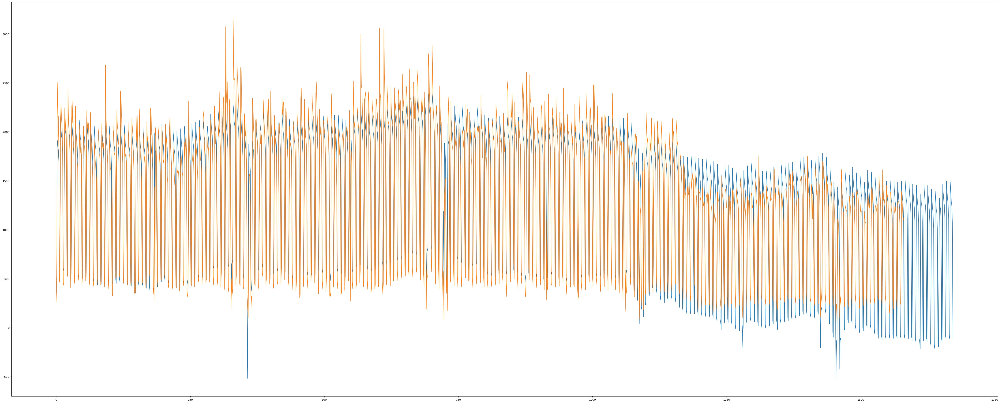

In [ ]:
fig = plt.figure()
fig.set_figheight(20)
fig.set_figwidth(50)
ax = fig.add_axes([1,1,1,1])
x = range(len(forecast))
x_org = range(len(fbp_data))
y_fbp = list(forecast.yhat.values)
y_org = all_cc
ax.plot(x, y_fbp)
ax.plot(x_org, all_cc)
plt.show()

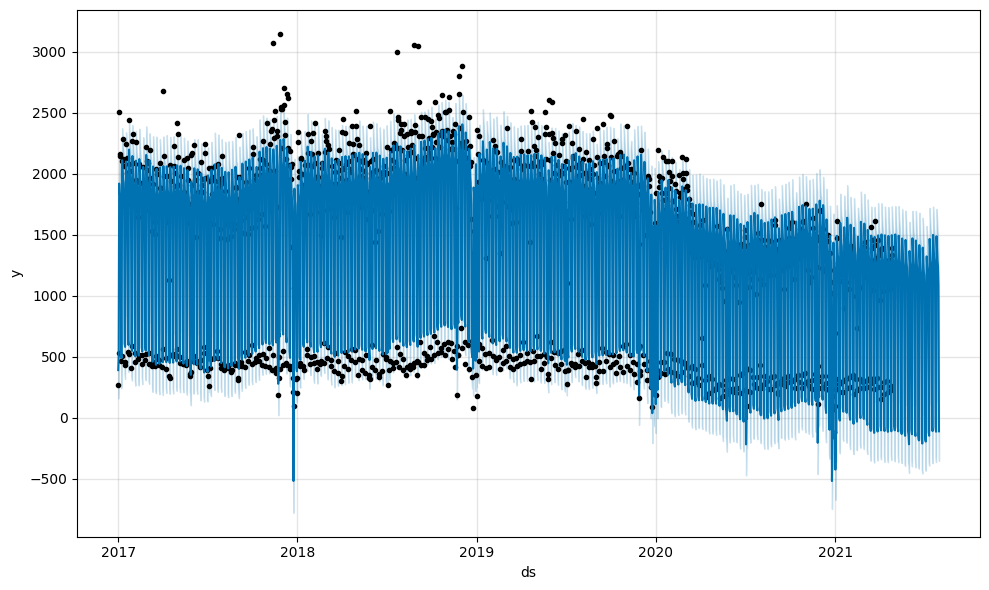

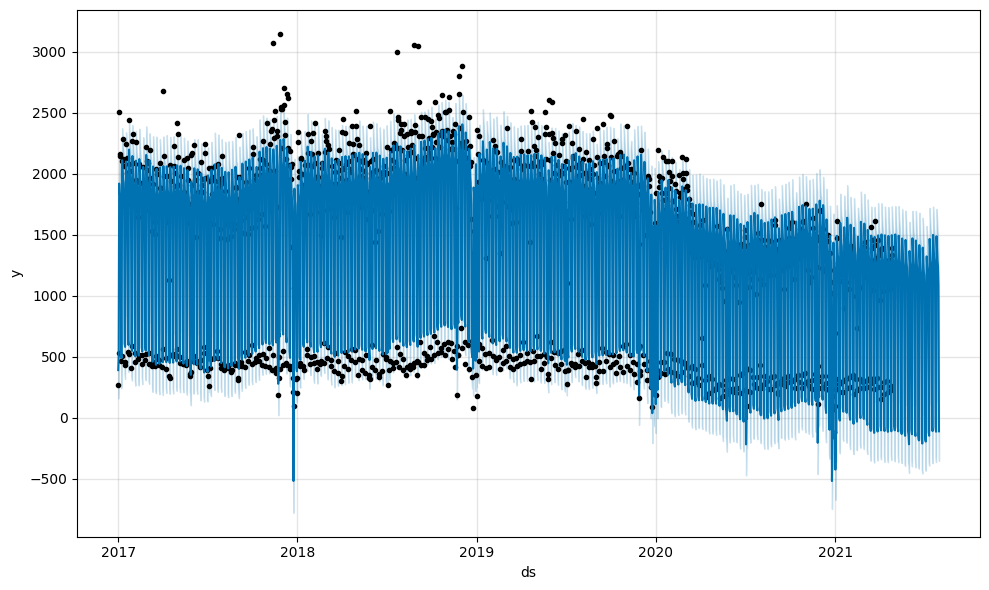

In [ ]:
fbp_model_fit.plot(forecast)

In [ ]:
# [ arrow.get(dt, "DD/MM/YYYY").day for dt in df_17['date'] ]



# df['Date'] = df['Date'].apply(lambda row: arrow.get(str(row), "M/D/YYYY").format("DD/MM/YYYY"))

# df.info()

# df['Year'] = df['Date'].apply(lambda row: arrow.get(row, "DD/MM/YYYY").year)

# df_17 = df[df['Year'] == 2017]

# df_17

# df_17.rename(columns = {"Date":"date", "No_of_calls_from_commercial_card":"cc", "No_of_calls_from_retail_card":"rc", "No_of_calls_from_student_card":"sc", "Year":"year"}, inplace=True)

# df_17

# plt.figure(figsize=(20, 20))
# plt.plot(df_17['date'], df_17['cc'], c='red', label='cc')
# plt.plot(df_17['date'], df_17['rc'], c='blue', label='rc')
# plt.plot(df_17['date'], df_17['sc'], c='green', label='sc')
# plt.legend()
# plt.show()

# df_17[['cc', 'rc', 'sc']]

# # (df_17.cc < df_17.rc).sum()
# ic(df_17.cc / df_17.rc, df_17.rc / df_17.sc, df_17.cc / df_17.rc == df_17.rc / df_17.sc)

# df_not17 = df[df['Year'] != 2017]

# df_not17

# df_not17.rename(columns = {"Date":"date", "No_of_calls_from_commercial_card":"cc", "No_of_calls_from_retail_card":"rc", "No_of_calls_from_student_card":"sc", "Year":"year"}, inplace=True)

# df_not17

# plt.figure(figsize=(20, 20))
# plt.plot(df_not17['date'], df_not17['cc'], c='red', label='cc')
# plt.plot(df_not17['date'], df_not17['rc'], c='blue', label='rc')
# plt.plot(df_not17['date'], df_not17['sc'], c='green', label='sc')
# plt.legend()
# plt.show()

# df_18 = df[df['Year'] == 2018]
# df_18.rename(columns = {"Date":"date", "No_of_calls_from_commercial_card":"cc", "No_of_calls_from_retail_card":"rc", "No_of_calls_from_student_card":"sc", "Year":"year"}, inplace=True)
# plt.figure(figsize=(20, 20))
# plt.plot(df_18['date'], df_18['cc'], c='red', label='cc')
# plt.plot(df_18['date'], df_18['rc'], c='blue', label='rc')
# plt.plot(df_18['date'], df_18['sc'], c='green', label='sc')
# plt.legend()
# plt.show()

# df_18

# df_not17

# df_not17.reset_index(inplace=True)

# df_not17.drop("index", axis=1, inplace=True)

# df_not17

# df_17.to_csv("df_17.csv")

# df_not17_sorted = pd.DataFrame(columns=['date', 'cc', 'rc', 'sc'])

# for index, row in df_not17.iterrows():
#     values = sorted([row.cc, row.rc, row.sc])
#     row_data = [row.date]
#     row_data.extend(values)
# #     print(row_data)
#     df_not17_sorted.loc[index] = row_data

# df_not17_sorted

# plt.figure(figsize=(30, 30))
# plt.plot(df_not17_sorted['date'], df_not17_sorted['cc'], c='red', label='cc')
# plt.plot(df_not17_sorted['date'], df_not17_sorted['rc'], c='blue', label='rc')
# plt.plot(df_not17_sorted['date'], df_not17_sorted['sc'], c='green', label='sc')
# plt.legend()
# plt.show()

# ic(df_17.cc / df_17.rc, df_17.rc / df_17.sc, df_17.cc / df_17.rc == df_17.rc / df_17.sc)
# ic(df_not17_sorted.cc / df_not17_sorted.rc, df_not17_sorted.rc / df_not17_sorted.sc, df_not17_sorted.cc / df_not17_sorted.rc == df_not17_sorted.rc / df_not17_sorted.sc)

# from math import round

# round(df_17.cc / df_17.rc, 2) == round(df_not17_sorted.cc[:365] / df_not17_sorted.rc[:365], 2)

# for a, b in zip(df_17.cc / df_17.rc, df_not17_sorted.cc[:365] / df_not17_sorted.rc[:365]):
#     print('%.1f'%a == '%.1f'%b)

# df_not17_sorted.to_csv("df_not17_sorted.csv")